In [1]:
import tweepy as tw
import json
import os
import requests
import sys
import warnings
import time
import random
import logging
warnings.filterwarnings("ignore")

In [2]:
import re
from os import walk
# Import nltk modules and download dataset
import nltk
from nltk.corpus import stopwords
from nltk.util import ngrams
from nltk.tokenize import word_tokenize
from nltk.tokenize.treebank import TreebankWordDetokenizer

nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

stop = set(stopwords.words('english'))
from datetime import datetime as dt
from datetime import timedelta as timedelta
from tqdm.notebook import tqdm
from collections import Counter

# Generate Word Cloud image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

# Data Science modules
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
plt.style.use('ggplot')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\eikde\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\eikde\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\eikde\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [3]:
def load_tweet(filename, dirpath):
    ''' Clean FinancialPhrasebank data
        Input:
            - filename
        Output:
            - a dataframe for the loaded financial phase bank data
    '''
    fullpath = dirpath + "/" + filename
    print("path: {0}".format(fullpath))
    with open(fullpath, 'r') as f:
        twits = json.load(f)

    #print(twits['data']['body'][:10])
    print("The number of twits is: ", len(twits['data']))
    timestamp = [twit['created_at'] for twit in twits['data']]
    messages = [twit['body'] for twit in twits['data']]
    
    # Since the sentiment scores are discrete, we'll scale the sentiments to 0 to 4 for use in the network
    sentiments = []
    for item in twits['data']:
        entities = item.get('entities')
        if entities['sentiment'] == None:
            sentiments.append(1)
        else:
            if entities['sentiment']['basic'] == 'Bullish':
                sentiments.append(2)
            elif entities['sentiment']['basic'] == 'Bearish':
                sentiments.append(0)
            else:
                sentiments.append(1)
        
    #print('Sample Messages: \n', messages[:10])
    return timestamp, messages, sentiments

In [4]:
def format_date(date):
    # Record the date of the earliest post in our dataset for stock price extraction
    start_date = min(date)[:10]
    # Convert time to Eastern Time (NY time)
    timestamp = [(dt.strptime(t, "%Y-%m-%dT%H:%M:%SZ")-timedelta(hours=4, minutes=0)) for t in date]
    twits_time_ET = [t.time() for t in timestamp]
    twits_date = [t.date() for t in timestamp]
    
    return timestamp, twits_time_ET, twits_date

In [5]:
def preprocess(message):
    """
    This function takes a string as input, then performs these operations: 
        - lowercase
        - remove URLs
        - remove ticker symbols 
        - removes punctuation
        - tokenize by splitting the string on whitespace 
        - removes any single character tokens
    
    Parameters
    ----------
        message : The text message to be preprocessed.
        
    Returns
    -------
        tokens: The preprocessed text into tokens.
    """ 
    # Lowercase the twit message
    text = message.lower()
    # Replace URLs with a space in the message
    text = re.sub('https?:\/\/[a-zA-Z0-9@:%._\/+~#=?&;-]*', ' ', text)
    
    # Replace ticker symbols with a space. The ticker symbols are any stock symbol that starts with $.
    text = re.sub('\$[a-zA-Z0-9]*', ' ', text)
    
    # Replace StockTwits usernames with a space. The usernames are any word that starts with @.
    text = re.sub('\@[a-zA-Z0-9]*', ' ', text)

    # Replace everything not a letter with a space
    text = re.sub('[^a-zA-Z]', ' ', text)

    # Remove stop words
    word_tokens = word_tokenize(text)
    filtered = []
    filtered = [w for w in word_tokens if not w in stop]
    filtered = TreebankWordDetokenizer().detokenize(filtered)
    
    return filtered

In [8]:
# Load data
path = "Data/StockTwits"

messages = []
sentiments = []
timestamps = []
twits_time_ETs = []
twits_dates = []
quotes = []

all_stock_label = pd.DataFrame()

for (dirpath, dirnames, filenames) in walk(path):
    for filename in filenames:
        quote = filename.split('.')[0]
        if filename.lower().endswith('.json'):
            timestamp, message, sentiment = load_tweet(str(filename), str(dirpath))
            timestamp, twits_time_ET, twits_date = format_date(timestamp)

            timestamps.append(timestamp)
            messages.append(message)
            sentiments.append(sentiment)
            twits_time_ETs.append(twits_time_ET)
            twits_dates.append(twits_date)
            quotes.append(quote)

            preprocessed = [preprocess(msg) for msg in message]

            tmp_dict = {'quote': quote, 'date': twits_date, 'time_ET': twits_time_ET, 
                        'org message': message, 'sentence': preprocessed, 'label': sentiment }
            data = pd.DataFrame(tmp_dict)
            all_stock_label = all_stock_label.append(data)

all_stock_label.to_csv(r"Data/StockTwits/StockTwits.csv", sep="\t")    

path: Data/StockTwits/AAPL.json
The number of twits is:  10020
path: Data/StockTwits/ABNB.json
The number of twits is:  10020
path: Data/StockTwits/ABT.json
The number of twits is:  10020
path: Data/StockTwits/AEP.json
The number of twits is:  9622
path: Data/StockTwits/AMT.json
The number of twits is:  10020
path: Data/StockTwits/AMZN.json
The number of twits is:  10020
path: Data/StockTwits/BAC.json
The number of twits is:  10020
path: Data/StockTwits/BBY.json
The number of twits is:  10019
path: Data/StockTwits/C.json
The number of twits is:  10020
path: Data/StockTwits/CCI.json
The number of twits is:  10019
path: Data/StockTwits/CI.json
The number of twits is:  10019
path: Data/StockTwits/CMG.json
The number of twits is:  10020
path: Data/StockTwits/COP.json
The number of twits is:  10020
path: Data/StockTwits/CSX.json
The number of twits is:  10015
path: Data/StockTwits/CVS.json
The number of twits is:  10020
path: Data/StockTwits/CVX.json
The number of twits is:  10019
path: Dat

In [6]:
# Check
test_message = 'RT @google Our annual looked at the year in Google blogging (and beyond) http://t.co/sptHOAh8 $GOOG'
print(preprocess(test_message))


rt annual looked year google blogging beyond


# Data Exploration

In [9]:
def explore_frequent_words(messages): 
    preprocesseds = []
    # Process for all messages
    for message in messages:
        preprocessed = [preprocess(msg) for msg in message]
        preprocesseds.append(preprocessed)

        all_words = [word for message in preprocessed for word in message.split()]
        print('The number of all words: ', len(all_words))

        counts = Counter(all_words)
        print('The number of unique words: ', len(counts))

        bow = sorted(counts, key=counts.get, reverse=True)
        print('Top 40 frequent words: ', bow[:40])

        text = " ".join(all_words)

        # Generate a word cloud image
        wordcloud = WordCloud(stopwords=None, max_font_size=50, max_words=100, background_color="white").generate(text)
        plt.figure(figsize=(15,7))
        # Display the generated image:
        # the matplotlib way:
        plt.imshow(wordcloud, interpolation="bilinear")
        plt.axis("off")
        plt.show()

The number of all words:  90048
The number of unique words:  9888
Top 40 frequent words:  ['apple', 'market', 'earnings', 'going', 'today', 'like', 'quot', 'buy', 'amp', 'get', 'puts', 'stock', 'tomorrow', 'time', 'new', 'go', 'day', 'see', 'good', 'next', 'china', 'week', 'back', 'short', 'calls', 'bears', 'lol', 'recession', 'money', 'big', 'one', 'inflation', 'last', 'think', 'let', 'would', 'price', 'long', 'still', 'call']


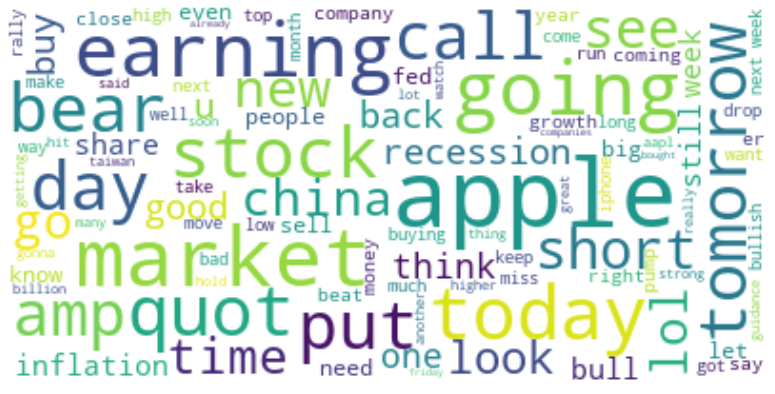

The number of all words:  92497
The number of unique words:  8248
Top 40 frequent words:  ['airbnb', 'market', 'buy', 'price', 'stock', 'options', 'amp', 'new', 'earnings', 'see', 'today', 'shares', 'travel', 'going', 'abnb', 'like', 'call', 'article', 'good', 'q', 'still', 'stocks', 'puts', 'target', 'get', 'day', 'sell', 'next', 'profile', 'back', 'k', 'tomorrow', 'worth', 'time', 'calls', 'put', 'go', 'week', 'short', 'long']


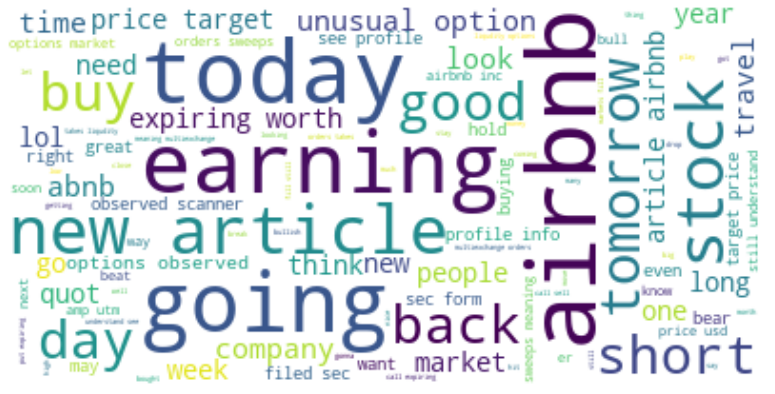

The number of all words:  120213
The number of unique words:  8781
Top 40 frequent words:  ['abbott', 'amp', 'new', 'laboratories', 'shares', 'options', 'k', 'alerted', 'worth', 'unusual', 'covid', 'sec', 'sweepcast', 'expiring', 'form', 'article', 'earnings', 'see', 'call', 'test', 'price', 'news', 'filed', 'activity', 'stocks', 'buy', 'today', 'daily', 'abt', 'day', 'delayed', 'stock', 'tests', 'market', 'first', 'value', 'fda', 'pre', 'put', 'digest']


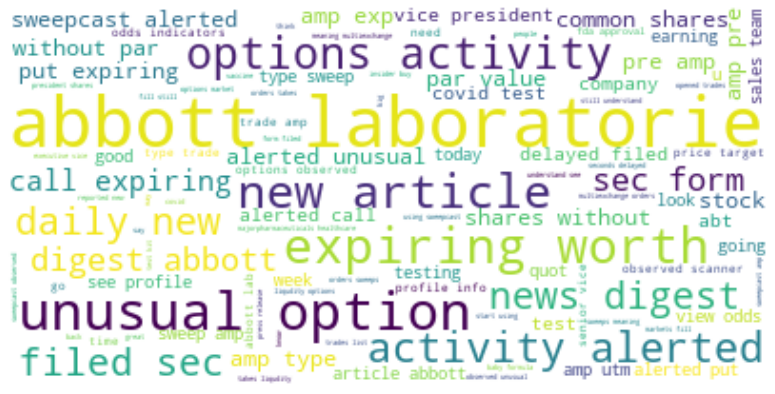

The number of all words:  94808
The number of unique words:  6371
Top 40 frequent words:  ['electric', 'american', 'power', 'amp', 'aep', 'stocks', 'new', 'utilities', 'company', 'earnings', 'form', 'filed', 'week', 'sec', 'shares', 'estimize', 'stock', 'trending', 'short', 'k', 'buy', 'utm', 'price', 'today', 'president', 'eps', 'inc', 'energy', 'delayed', 'q', 'article', 'dividend', 'call', 'vice', 'report', 'b', 'options', 'director', 'quarterly', 'rating']


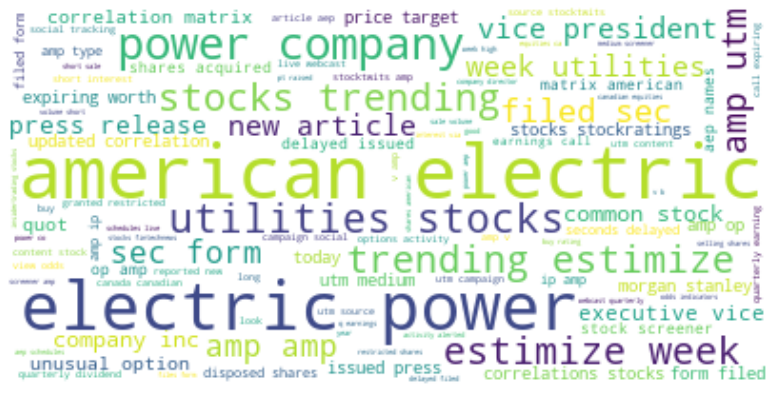

The number of all words:  118603
The number of unique words:  7705
Top 40 frequent words:  ['tower', 'american', 'amp', 'new', 'corporation', 'stock', 'form', 'filed', 'stocks', 'daily', 'k', 'price', 'sec', 'options', 'news', 'buy', 'article', 'shares', 'utm', 'earnings', 'delayed', 'amt', 'today', 'digest', 'release', 'worth', 'unusual', 'call', 'g', 'expiring', 'reit', 'financial', 'short', 'b', 'see', 'long', 'suggestions', 'press', 'portfolio', 'market']


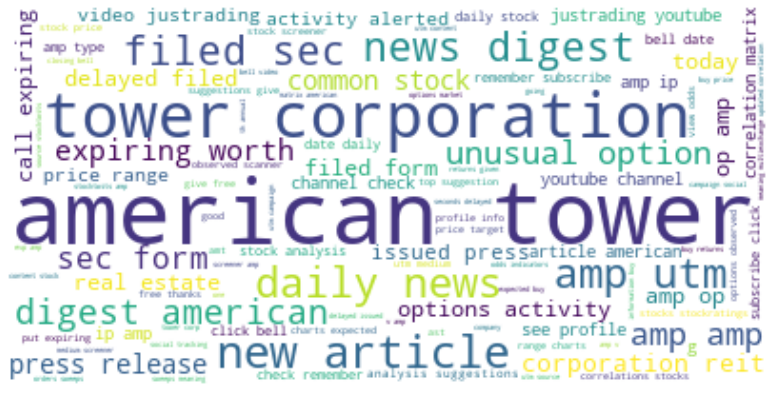

The number of all words:  85622
The number of unique words:  9153
Top 40 frequent words:  ['amazon', 'market', 'earnings', 'going', 'today', 'buy', 'like', 'tomorrow', 'day', 'stock', 'get', 'see', 'next', 'back', 'good', 'bears', 'time', 'go', 'week', 'amp', 'gt', 'quot', 'puts', 'calls', 'amzn', 'price', 'big', 'money', 'lol', 'short', 'long', 'still', 'let', 'think', 'new', 'last', 'one', 'billion', 'sell', 'call']


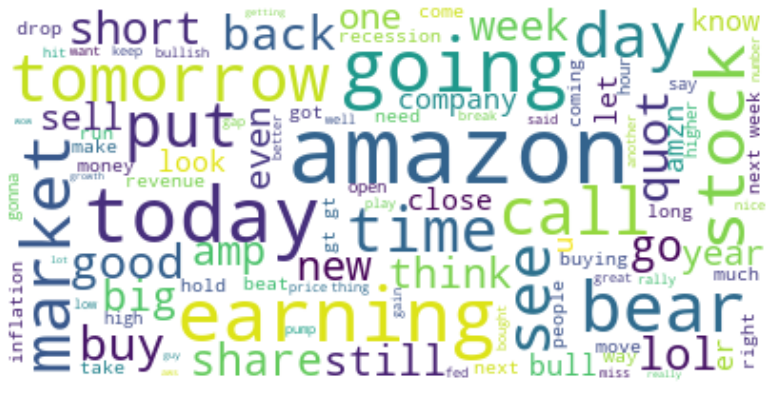

The number of all words:  111176
The number of unique words:  8807
Top 40 frequent words:  ['bank', 'options', 'market', 'america', 'k', 'trading', 'contracts', 'stock', 'profile', 'sweep', 'banks', 'call', 'analysis', 'buy', 'activity', 'today', 'stocks', 'link', 'new', 'institutions', 'included', 'screenshot', 'dashboard', 'quot', 'week', 'put', 'see', 'earnings', 'bac', 'amp', 'price', 'going', 'insiderfinance', 'io', 'next', 'day', 'good', 'go', 'option', 'like']


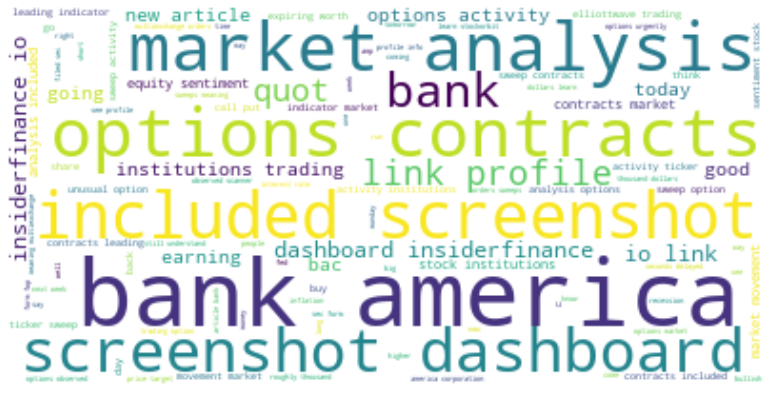

The number of all words:  104456
The number of unique words:  8373
Top 40 frequent words:  ['buy', 'best', 'amp', 'options', 'earnings', 'k', 'price', 'unusual', 'stock', 'new', 'see', 'worth', 'alerted', 'expiring', 'sweepcast', 'call', 'shares', 'activity', 'stocks', 'market', 'put', 'puts', 'bby', 'today', 'form', 'target', 'co', 'like', 'sell', 'day', 'sec', 'insider', 'time', 'week', 'exp', 'article', 'filed', 'short', 'last', 'news']


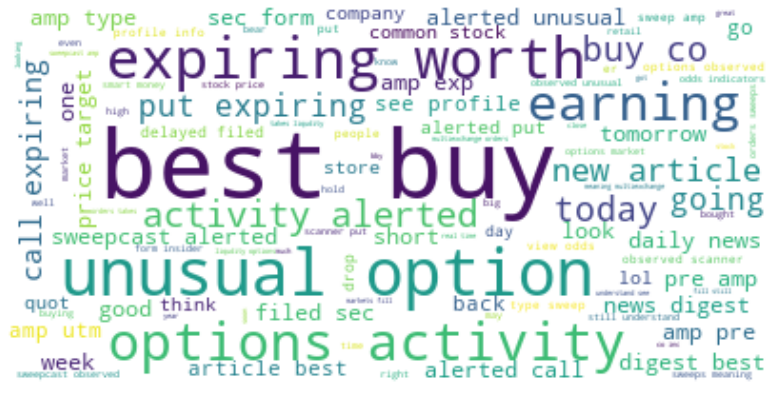

The number of all words:  120343
The number of unique words:  8870
Top 40 frequent words:  ['citigroup', 'form', 'filed', 'sec', 'inc', 'b', 'options', 'fwp', 'market', 'filing', 'stock', 'new', 'k', 'free', 'citi', 'securities', 'act', 'today', 'rules', 'writing', 'prospectuses', 'earnings', 'buy', 'price', 'contracts', 'trading', 'sweep', 'banks', 'tp', 'profile', 'bank', 'call', 'delayed', 'c', 'activity', 'stocks', 'shares', 'institutions', 'see', 'analysis']


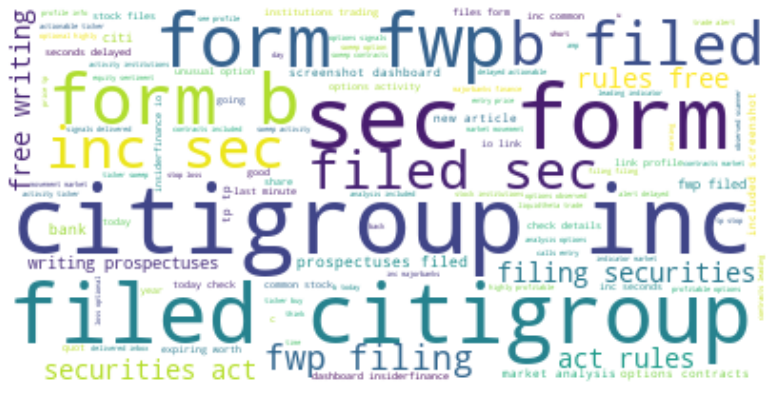

The number of all words:  97914
The number of unique words:  6783
Top 40 frequent words:  ['crown', 'castle', 'amp', 'international', 'new', 'earnings', 'stocks', 'form', 'stock', 'filed', 'daily', 'k', 'news', 'buy', 'sec', 'shares', 'price', 'short', 'digest', 'corp', 'today', 'cci', 'options', 'report', 'delayed', 'call', 'dividend', 'corporation', 'release', 'quot', 'g', 'utm', 'q', 'market', 'portfolio', 'announces', 'common', 'sh', 'volume', 'x']


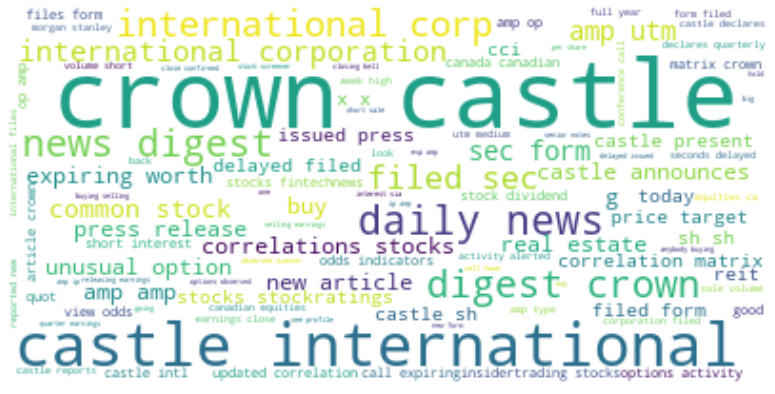

The number of all words:  103728
The number of unique words:  7864
Top 40 frequent words:  ['cigna', 'amp', 'corporation', 'new', 'form', 'news', 'stocks', 'stock', 'filed', 'sec', 'price', 'daily', 'earnings', 'k', 'options', 'health', 'digest', 'shares', 'delayed', 'today', 'worth', 'ci', 'unusual', 'healthcare', 'call', 'see', 'buy', 'expiring', 'insider', 'common', 'portfolio', 'day', 'alerted', 'sweepcast', 'care', 'average', 'market', 'article', 'eps', 'target']


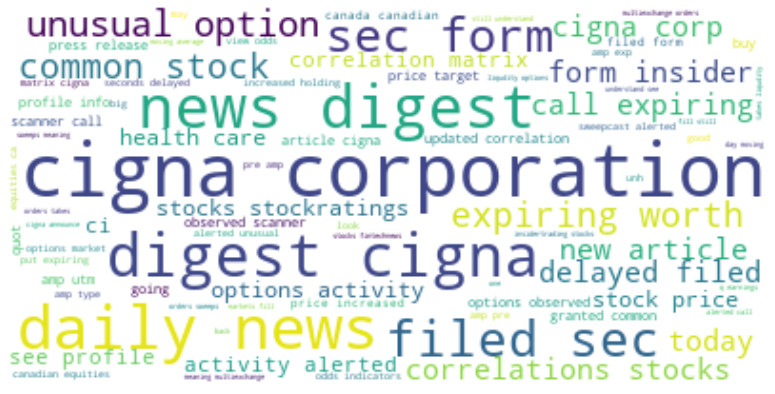

The number of all words:  102081
The number of unique words:  9052
Top 40 frequent words:  ['chipotle', 'mexican', 'grill', 'new', 'price', 'stock', 'earnings', 'options', 'k', 'cmg', 'see', 'worth', 'like', 'amp', 'buy', 'unusual', 'article', 'food', 'expiring', 'market', 'today', 'target', 'day', 'get', 'still', 'next', 'time', 'shares', 'week', 'call', 'put', 'last', 'orders', 'going', 'short', 'sweepcast', 'stocks', 'one', 'puts', 'quot']


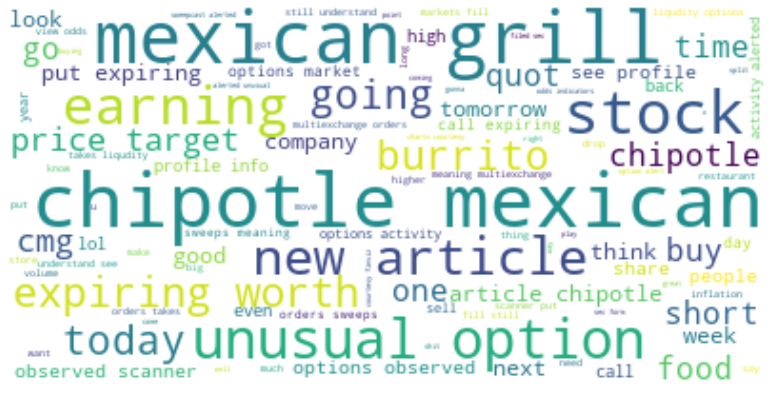

The number of all words:  123534
The number of unique words:  8762
Top 40 frequent words:  ['amp', 'conocophillips', 'oil', 'options', 'new', 'alerted', 'k', 'energy', 'unusual', 'stocks', 'worth', 'sweepcast', 'call', 'expiring', 'form', 'see', 'buy', 'filed', 'activity', 'price', 'stock', 'today', 'sec', 'cop', 'shares', 'exp', 'company', 'earnings', 'utm', 'delayed', 'quot', 'type', 'pre', 'article', 'put', 'news', 'day', 'daily', 'observed', 'sweep']


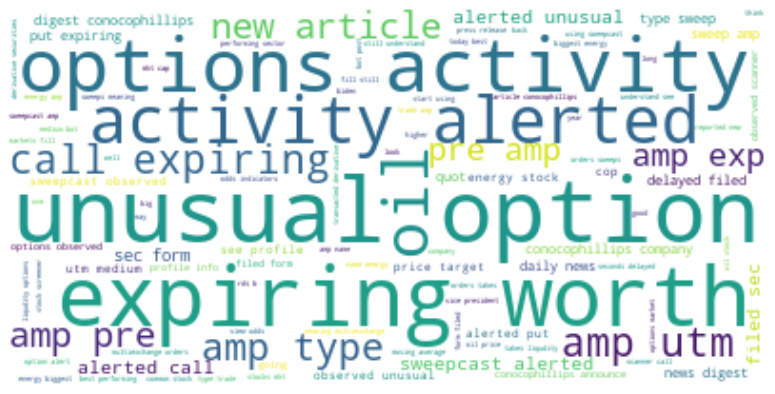

The number of all words:  100800
The number of unique words:  7321
Top 40 frequent words:  ['csx', 'amp', 'earnings', 'new', 'stocks', 'corporation', 'stock', 'options', 'news', 'form', 'daily', 'k', 'filed', 'sec', 'utm', 'price', 'today', 'digest', 'call', 'shares', 'alerted', 'buy', 'week', 'market', 'unusual', 'worth', 'see', 'article', 'short', 'expiring', 'corp', 'delayed', 'x', 'day', 'sweepcast', 'volume', 'quarter', 'trades', 'portfolio', 'financial']


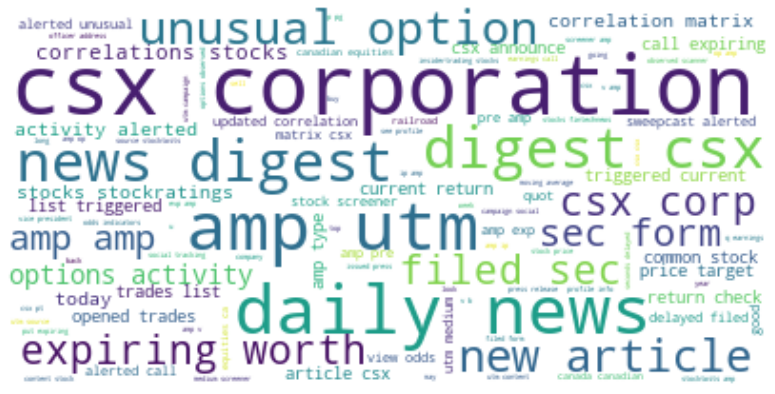

The number of all words:  117156
The number of unique words:  8853
Top 40 frequent words:  ['cvs', 'amp', 'health', 'options', 'tp', 'k', 'alerted', 'price', 'buy', 'new', 'trade', 'unusual', 'delayed', 'sweepcast', 'worth', 'expiring', 'calls', 'call', 'activity', 'earnings', 'see', 'alert', 'exp', 'stock', 'today', 'stop', 'pre', 'ticker', 'entry', 'actionable', 'type', 'profitable', 'loss', 'highly', 'delivered', 'signals', 'liquidtheta', 'optional', 'inbox', 'stocks']


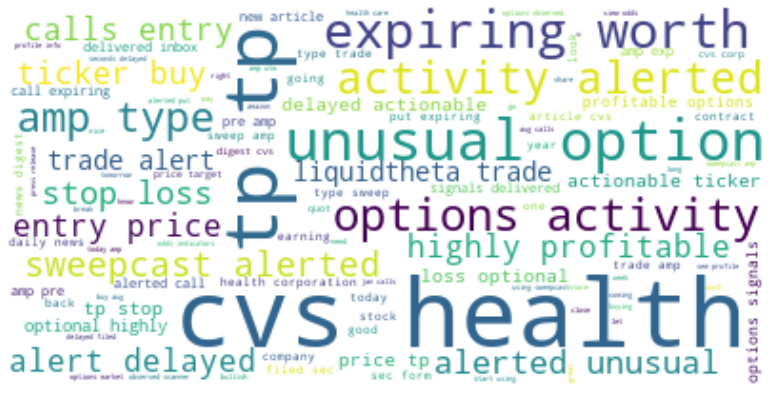

The number of all words:  129845
The number of unique words:  11361
Top 40 frequent words:  ['oil', 'chevron', 'amp', 'quot', 'new', 'price', 'energy', 'stocks', 'options', 'gas', 'buy', 'market', 'stock', 'prices', 'see', 'today', 'k', 'biden', 'still', 'week', 'like', 'trading', 'us', 'time', 'get', 'earnings', 'going', 'shares', 'article', 'call', 'day', 'go', 'high', 'good', 'form', 'cvx', 'year', 'delayed', 'worth', 'b']


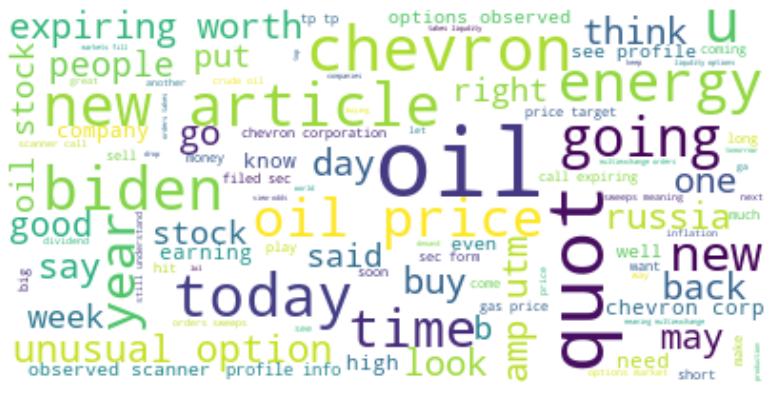

The number of all words:  103584
The number of unique words:  7769
Top 40 frequent words:  ['dominion', 'energy', 'amp', 'earnings', 'new', 'stocks', 'stock', 'form', 'buy', 'filed', 'short', 'price', 'resources', 'k', 'eps', 'sec', 'today', 'options', 'shares', 'dividend', 'q', 'volume', 'report', 'utilities', 'call', 'long', 'financial', 'b', 'article', 'portfolio', 'top', 'see', 'inc', 'delayed', 'suggestions', 'estimates', 'market', 'ago', 'announces', 'check']


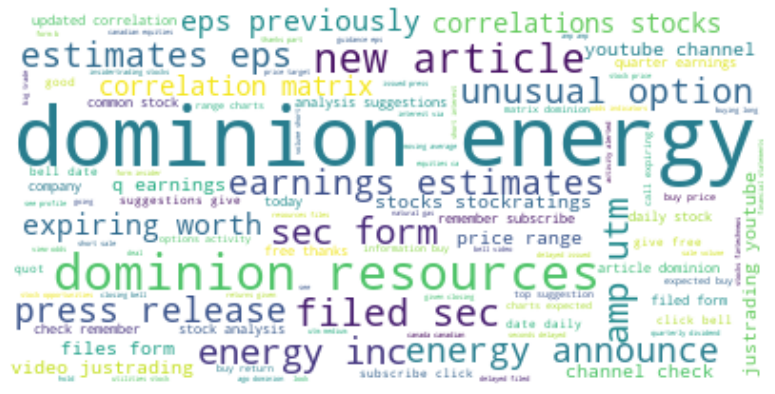

The number of all words:  118185
The number of unique words:  7801
Top 40 frequent words:  ['energy', 'duke', 'amp', 'new', 'form', 'filed', 'sec', 'stocks', 'k', 'stock', 'delayed', 'shares', 'price', 'carolina', 'earnings', 'florida', 'short', 'customers', 'duk', 'options', 'article', 'buy', 'release', 'today', 'portfolio', 'utilities', 'quot', 'press', 'north', 'call', 'financial', 'worth', 'b', 'unusual', 'alerted', 'power', 'common', 'solar', 'see', 'natural']


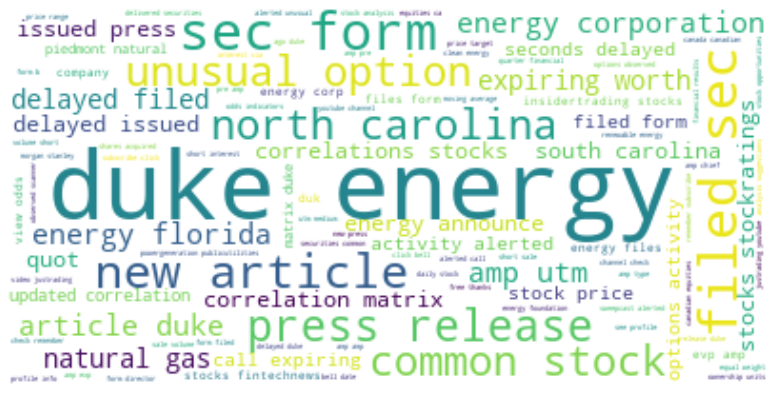

The number of all words:  93484
The number of unique words:  7206
Top 40 frequent words:  ['anthem', 'amp', 'inc', 'new', 'earnings', 'news', 'daily', 'health', 'stock', 'stocks', 'options', 'buy', 'price', 'k', 'form', 'today', 'filed', 'digest', 'utm', 'short', 'sec', 'b', 'trade', 'call', 'shares', 'healthcare', 'antm', 'eps', 'q', 'worth', 'market', 'see', 'target', 'expiring', 'volume', 'article', 'day', 'unusual', 'calls', 'move']


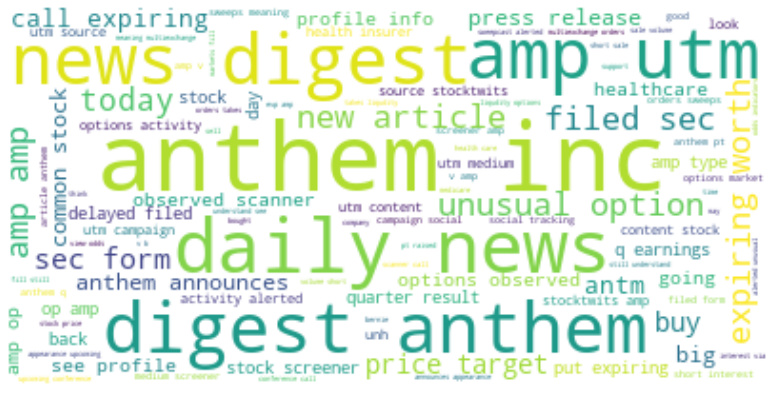

The number of all words:  119594
The number of unique words:  7571
Top 40 frequent words:  ['eog', 'resources', 'amp', 'stocks', 'price', 'options', 'energy', 'sec', 'stock', 'form', 'oil', 'new', 'filed', 'k', 'shares', 'call', 'buy', 'today', 'alerted', 'unusual', 'daily', 'see', 'worth', 'news', 'expiring', 'sweepcast', 'earnings', 'insider', 'p', 'utm', 'activity', 'digest', 'common', 'delayed', 'short', 'market', 'trade', 'day', 'exp', 'b']


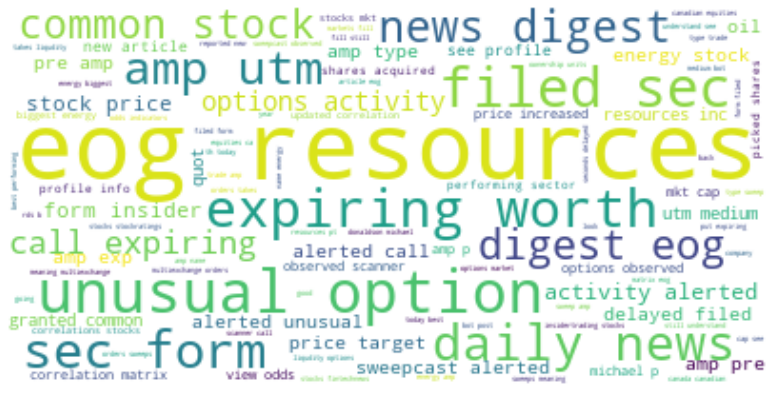

The number of all words:  92857
The number of unique words:  6473
Top 40 frequent words:  ['equinix', 'amp', 'shares', 'form', 'filed', 'stock', 'new', 'sec', 'insider', 'price', 'k', 'buy', 'data', 'delayed', 'earnings', 'common', 'sold', 'today', 'stocks', 'quot', 'inc', 'chief', 'officer', 'pt', 'disposed', 'eqix', 'options', 'reports', 'alert', 'center', 'rating', 'b', 'utm', 'report', 'call', 'financial', 'short', 'target', 'real', 'quarter']


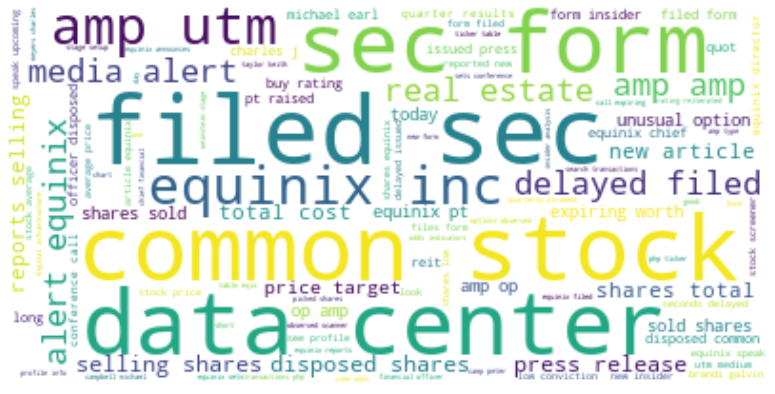

The number of all words:  106922
The number of unique words:  8918
Top 40 frequent words:  ['fedex', 'amp', 'options', 'buy', 'tp', 'price', 'earnings', 'calls', 'new', 'long', 'k', 'stock', 'trade', 'see', 'market', 'term', 'fdx', 'delayed', 'unusual', 'today', 'day', 'call', 'expiring', 'worth', 'alert', 'bullish', 'sweepcast', 'puts', 'like', 'stop', 'time', 'alerted', 'good', 'article', 'get', 'going', 'entry', 'loss', 'business', 'still']


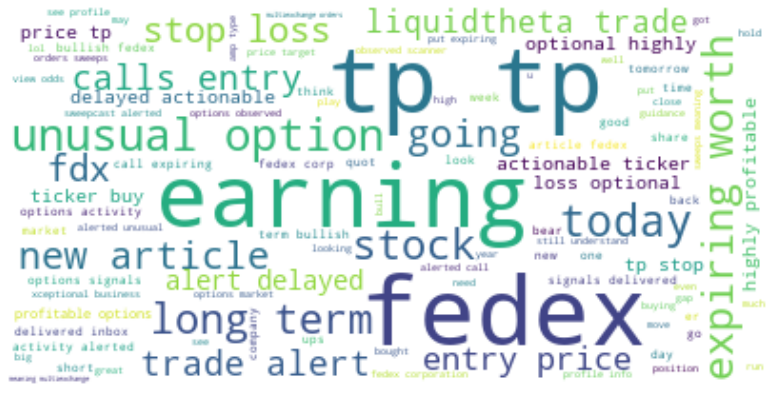

The number of all words:  99754
The number of unique words:  8051
Top 40 frequent words:  ['fluor', 'amp', 'corporation', 'new', 'k', 'form', 'stocks', 'earnings', 'news', 'filed', 'call', 'options', 'sec', 'daily', 'stock', 'shares', 'alerted', 'short', 'digest', 'unusual', 'flr', 'sweepcast', 'today', 'expiring', 'activity', 'delayed', 'worth', 'volume', 'see', 'x', 'buy', 'release', 'price', 'contract', 'portfolio', 'report', 'quarter', 'exp', 'press', 'market']


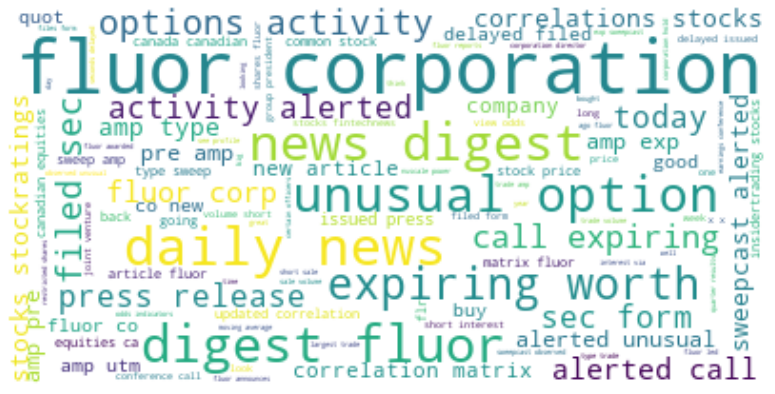

The number of all words:  16775
The number of unique words:  2104
Top 40 frequent words:  ['frontier', 'communications', 'form', 'new', 'delayed', 'sec', 'filed', 'amp', 'parent', 'release', 'k', 'press', 'present', 'fiber', 'inc', 'conference', 'price', 'securities', 'stock', 'chief', 'fybr', 'seconds', 'officer', 'financial', 'report', 'company', 'issued', 'nasdaq', 'et', 'today', 'notes', 'shares', 'may', 'annual', 'earnings', 'q', 'broadband', 'quarter', 'common', 'article']


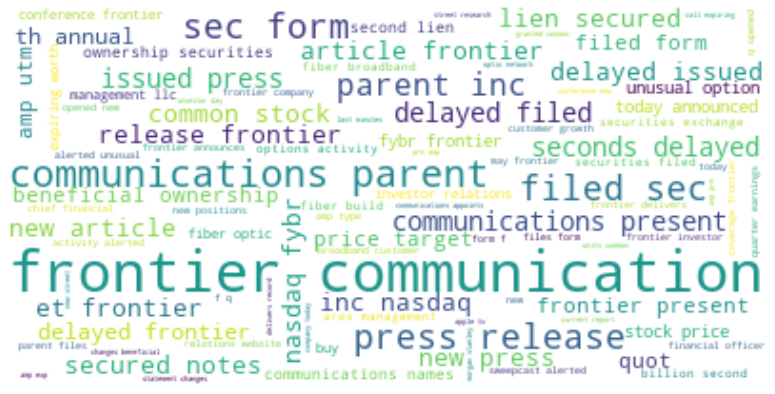

The number of all words:  103582
The number of unique words:  10855
Top 40 frequent words:  ['google', 'quot', 'market', 'stock', 'split', 'buy', 'amp', 'new', 'like', 'today', 'earnings', 'alphabet', 'options', 'going', 'price', 'week', 'see', 'next', 'tomorrow', 'time', 'day', 'get', 'good', 'article', 'shares', 'fed', 'big', 'back', 'long', 'go', 'one', 'k', 'x', 'still', 'tech', 'stocks', 'would', 'goog', 'think', 'july']


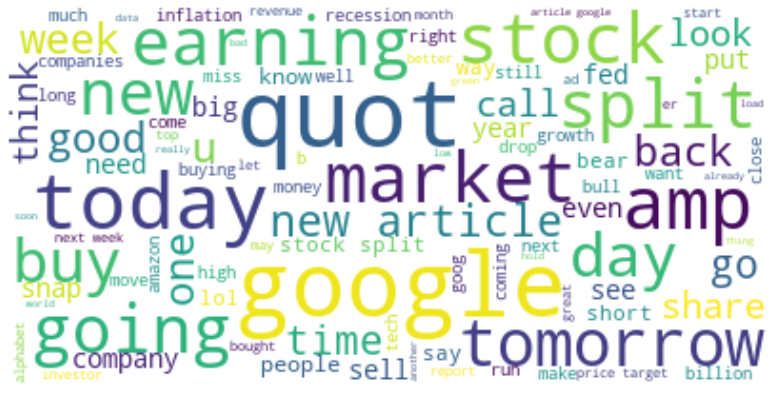

The number of all words:  127750
The number of unique words:  10943
Top 40 frequent words:  ['goldman', 'sachs', 'form', 'filed', 'sec', 'delayed', 'group', 'fwp', 'options', 'amp', 'buy', 'tp', 'quot', 'price', 'new', 'inc', 'trade', 'market', 'stock', 'calls', 'k', 'earnings', 'free', 'securities', 'b', 'see', 'call', 'filing', 'today', 'stocks', 'alert', 'banks', 'seconds', 'gs', 'unusual', 'article', 'act', 'day', 'writing', 'shares']


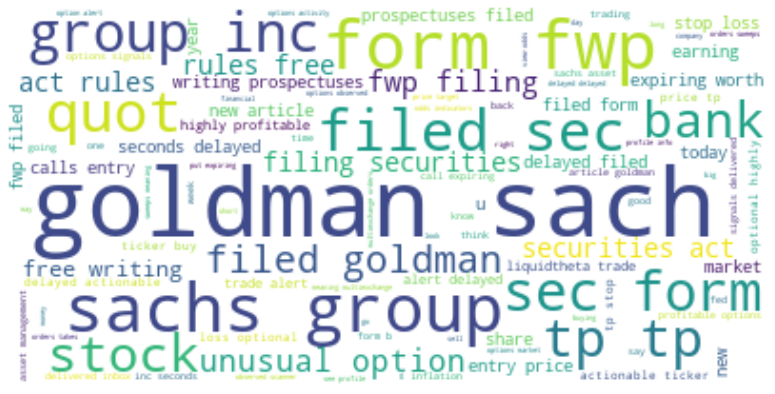

The number of all words:  114932
The number of unique words:  9837
Top 40 frequent words:  ['b', 'filing', 'form', 'filed', 'sec', 'chase', 'jpmorgan', 'rule', 'prospectus', 'new', 'amp', 'quot', 'morgan', 'market', 'buy', 'earnings', 'fwp', 'banks', 'delayed', 'last', 'options', 'co', 'stock', 'today', 'see', 'jp', 'minutes', 'price', 'bank', 'k', 'like', 'jpm', 'call', 'going', 'week', 'profile', 'get', 'dimon', 'p', 'may']


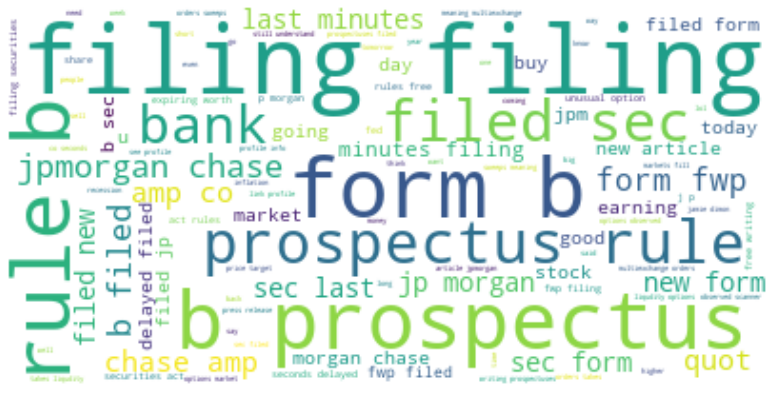

The number of all words:  143959
The number of unique words:  11023
Top 40 frequent words:  ['lumen', 'quot', 'amp', 'options', 'stock', 'technologies', 'k', 'shares', 'dividend', 'alerted', 'see', 'call', 'unusual', 'worth', 'new', 'sweepcast', 'activity', 'today', 'market', 'expiring', 'price', 'company', 'like', 'billion', 'share', 'buy', 'day', 'x', 'get', 'short', 'year', 'back', 'lumn', 'good', 'earnings', 'one', 'fiber', 'going', 'quarter', 'storey']


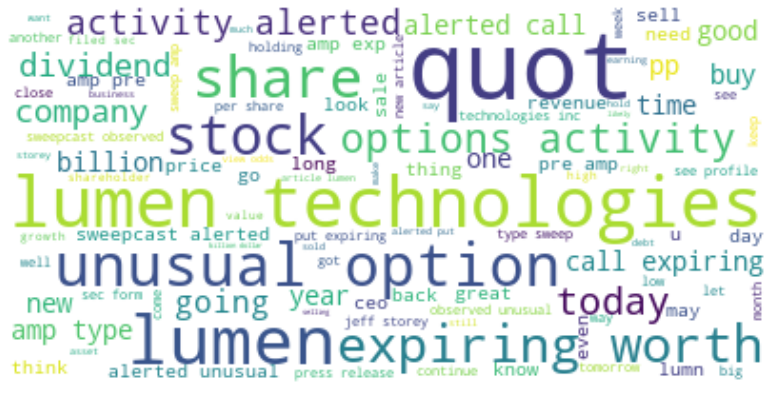

The number of all words:  114963
The number of unique words:  9618
Top 40 frequent words:  ['marriott', 'international', 'amp', 'new', 'options', 'k', 'stock', 'stocks', 'form', 'earnings', 'market', 'sec', 'filed', 'unusual', 'worth', 'shares', 'see', 'short', 'alerted', 'expiring', 'price', 'buy', 'today', 'hotels', 'sweepcast', 'class', 'mar', 'hotel', 'article', 'travel', 'delayed', 'call', 'activity', 'day', 'get', 'quarter', 'marriot', 'put', 'week', 'still']


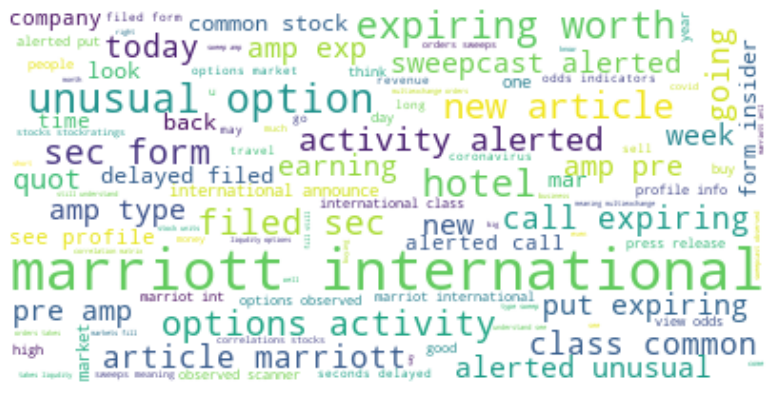

The number of all words:  120417
The number of unique words:  10487
Top 40 frequent words:  ['mcdonald', 'amp', 'tp', 'buy', 'options', 'price', 'new', 'x', 'mcdonalds', 'trade', 'long', 'calls', 'delayed', 'term', 'stock', 'see', 'article', 'alert', 'k', 'stop', 'earnings', 'unusual', 'worth', 'loss', 'actionable', 'ticker', 'entry', 'highly', 'delivered', 'profitable', 'expiring', 'today', 'signals', 'alerted', 'liquidtheta', 'optional', 'inbox', 'mcd', 'market', 'time']


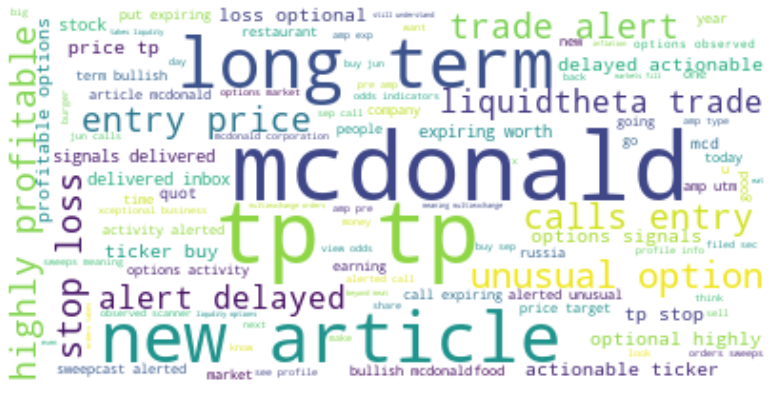

The number of all words:  125589
The number of unique words:  9253
Top 40 frequent words:  ['medtronic', 'amp', 'new', 'options', 'k', 'bod', 'alerted', 'unusual', 'worth', 'sweepcast', 'expiring', 'delayed', 'shares', 'price', 'activity', 'see', 'buy', 'stocks', 'form', 'today', 'news', 'earnings', 'mdt', 'filed', 'sec', 'plc', 'call', 'market', 'article', 'put', 'daily', 'announces', 'system', 'fda', 'ceo', 'pre', 'company', 'stock', 'medical', 'quot']


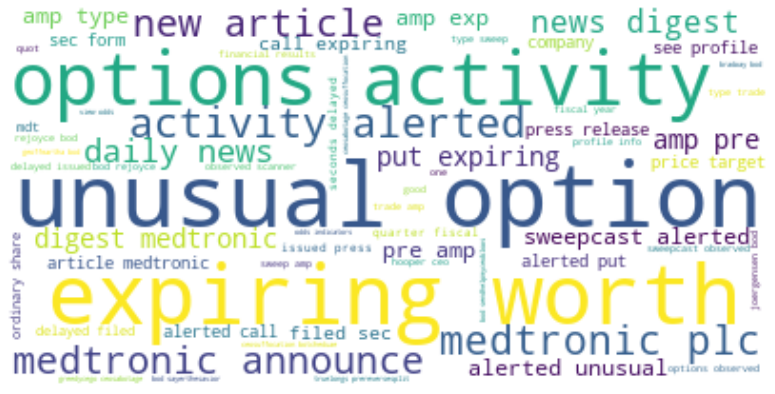

The number of all words:  85183
The number of unique words:  9267
Top 40 frequent words:  ['meta', 'market', 'earnings', 'buy', 'going', 'like', 'today', 'stock', 'see', 'quot', 'get', 'tomorrow', 'week', 'go', 'time', 'company', 'day', 'back', 'lol', 'facebook', 'next', 'puts', 'good', 'price', 'still', 'big', 'new', 'one', 'bears', 'money', 'options', 'sell', 'amp', 'calls', 'short', 'think', 'metaverse', 'miss', 'revenue', 'bad']


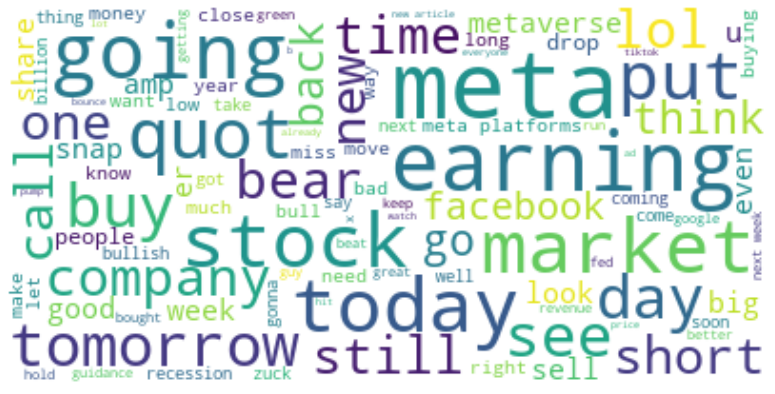

The number of all words:  111763
The number of unique words:  7245
Top 40 frequent words:  ['form', 'filed', 'fwp', 'sec', 'morgan', 'stanley', 'filing', 'delayed', 'free', 'securities', 'act', 'writing', 'rules', 'prospectuses', 'seconds', 'new', 'options', 'last', 'stock', 'minutes', 'may', 'march', 'k', 'earnings', 'market', 'april', 'today', 'call', 'worth', 'see', 'buy', 'unusual', 'amp', 'expiring', 'price', 'quot', 'profile', 'orders', 'insights', 'g']


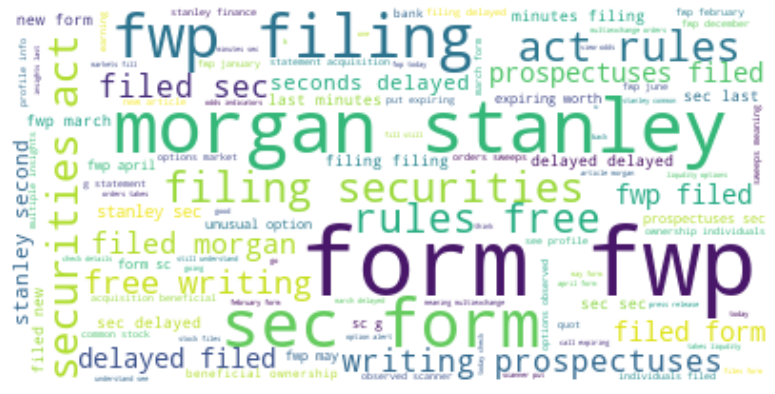

The number of all words:  109089
The number of unique words:  10717
Top 40 frequent words:  ['market', 'microsoft', 'earnings', 'buy', 'quot', 'amp', 'target', 'like', 'today', 'going', 'stock', 'options', 'week', 'see', 'k', 'tomorrow', 'day', 'next', 'new', 'price', 'big', 'get', 'time', 'gt', 'good', 'short', 'puts', 'trading', 'go', 'stocks', 'call', 'one', 'calls', 'back', 'fed', 'money', 'still', 'msft', 'put', 'last']


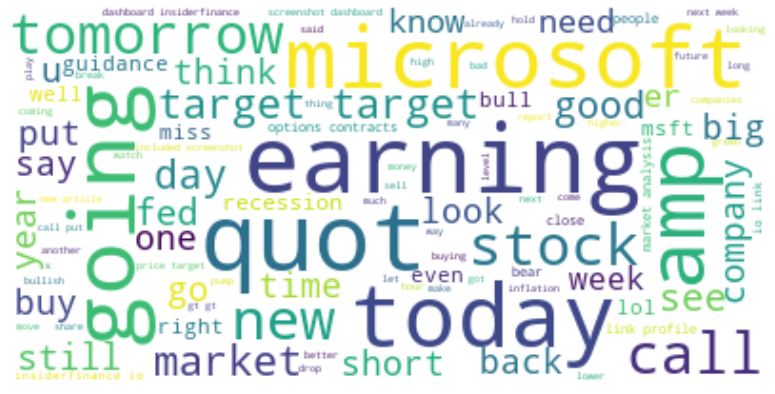

The number of all words:  107402
The number of unique words:  7971
Top 40 frequent words:  ['energy', 'nextera', 'amp', 'options', 'k', 'new', 'form', 'stock', 'alerted', 'stocks', 'unusual', 'worth', 'filed', 'sweepcast', 'expiring', 'sec', 'call', 'see', 'shares', 'today', 'buy', 'activity', 'delayed', 'price', 'nee', 'market', 'daily', 'news', 'earnings', 'company', 'exp', 'pre', 'long', 'financial', 'day', 'observed', 'trade', 'article', 'type', 'good']


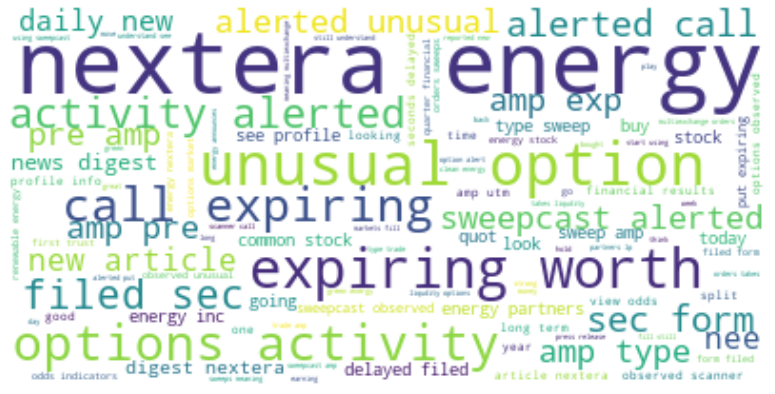

The number of all words:  96906
The number of unique words:  6886
Top 40 frequent words:  ['norfolk', 'southern', 'amp', 'form', 'new', 'filed', 'sec', 'shares', 'earnings', 'corporation', 'stocks', 'stock', 'insider', 'souther', 'k', 'short', 'delayed', 'options', 'securities', 'today', 'q', 'nsc', 'utm', 'price', 'report', 'buy', 'call', 'b', 'pt', 'trading', 'rating', 'week', 'quot', 'corp', 'volume', 'worth', 'unusual', 'dividend', 'expiring', 'financial']


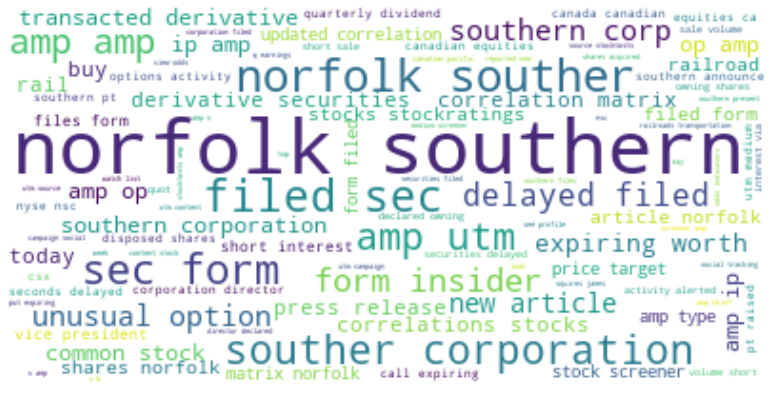

The number of all words:  95608
The number of unique words:  9192
Top 40 frequent words:  ['market', 'today', 'pelosi', 'buy', 'stock', 'week', 'nvda', 'options', 'like', 'day', 'going', 'quot', 'see', 'bill', 'trading', 'back', 'get', 'calls', 'next', 'k', 'tomorrow', 'good', 'time', 'nvidia', 'trade', 'nancy', 'call', 'go', 'amp', 'chips', 'price', 'stocks', 'chip', 'short', 'money', 'analysis', 'contracts', 'put', 'big', 'let']


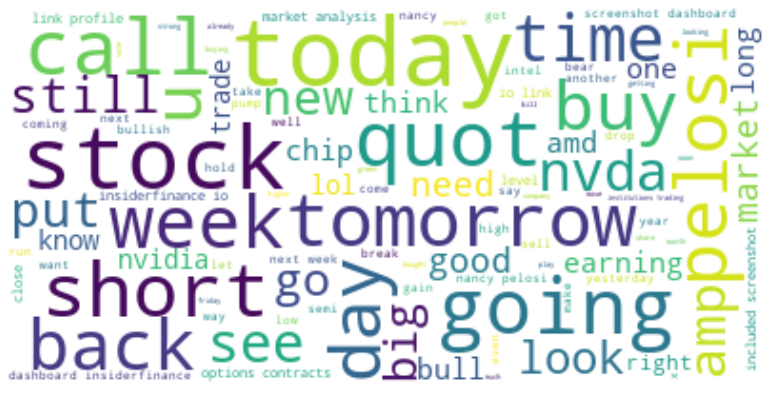

The number of all words:  106336
The number of unique words:  9430
Top 40 frequent words:  ['oil', 'market', 'options', 'buy', 'oxy', 'today', 'see', 'week', 'price', 'stock', 'short', 'going', 'occidental', 'quot', 'shares', 'still', 'like', 'k', 'buffett', 'profile', 'amp', 'get', 'time', 'back', 'energy', 'call', 'day', 'sell', 'go', 'petroleum', 'contracts', 'buffet', 'next', 'buying', 'gas', 'prices', 'trading', 'good', 'long', 'warren']


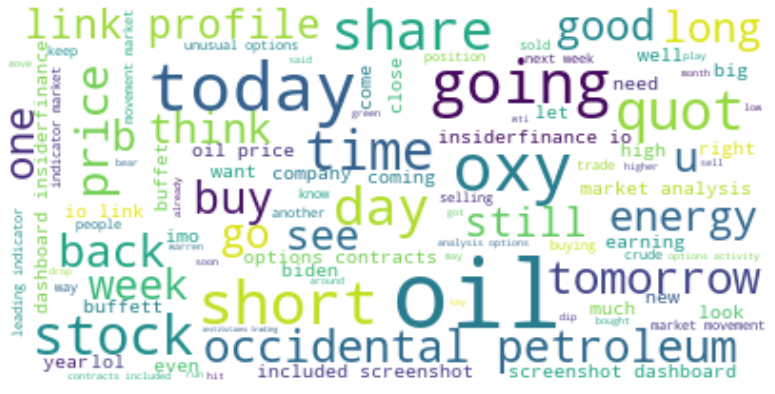

The number of all words:  83769
The number of unique words:  5893
Top 40 frequent words:  ['prologis', 'amp', 'new', 'earnings', 'stocks', 'filed', 'form', 'shares', 'sec', 'options', 'k', 'property', 'stock', 'buy', 'short', 'amb', 'corporation', 'pld', 'report', 'director', 'unusual', 'worth', 'call', 'real', 'utm', 'portfolio', 'expiring', 'financial', 'today', 'inc', 'volume', 'see', 'q', 'price', 'high', 'estate', 'trade', 'results', 'alerted', 'correlations']


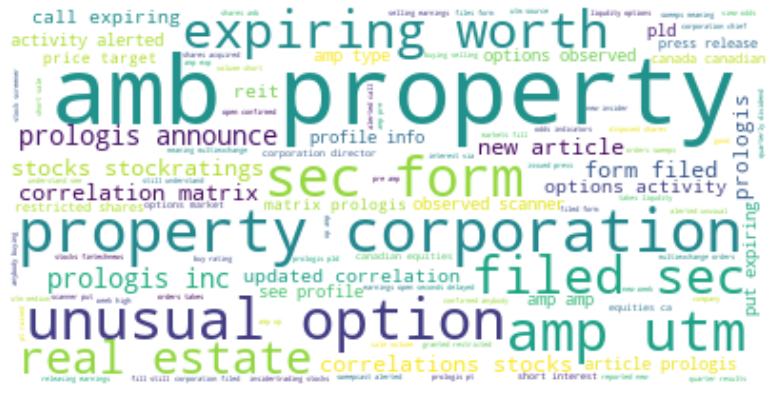

The number of all words:  81861
The number of unique words:  5381
Top 40 frequent words:  ['storage', 'public', 'amp', 'form', 'filed', 'sec', 'shares', 'new', 'stocks', 'stock', 'earnings', 'utm', 'delayed', 'today', 'price', 'short', 'b', 'k', 'securities', 'director', 'list', 'psa', 'screener', 'trades', 'check', 'current', 'op', 'report', 'options', 'portfolio', 'q', 'real', 'return', 'announces', 'release', 'p', 'quot', 'buy', 'opened', 'v']


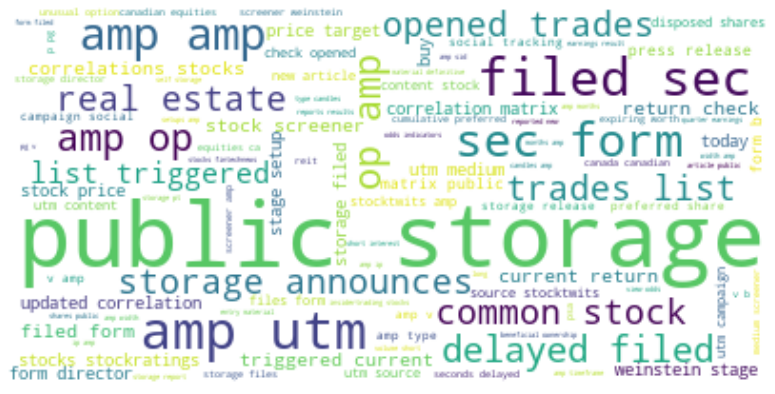

The number of all words:  102253
The number of unique words:  10012
Top 40 frequent words:  ['starbucks', 'coffee', 'new', 'buy', 'options', 'stock', 'earnings', 'market', 'price', 'today', 'see', 'like', 'article', 'china', 'get', 'call', 'going', 'k', 'go', 'good', 'sbux', 'day', 'company', 'amp', 'still', 'trade', 'back', 'time', 'quot', 'calls', 'q', 'week', 'stores', 'long', 'worth', 'people', 'shares', 'profile', 'puts', 'year']


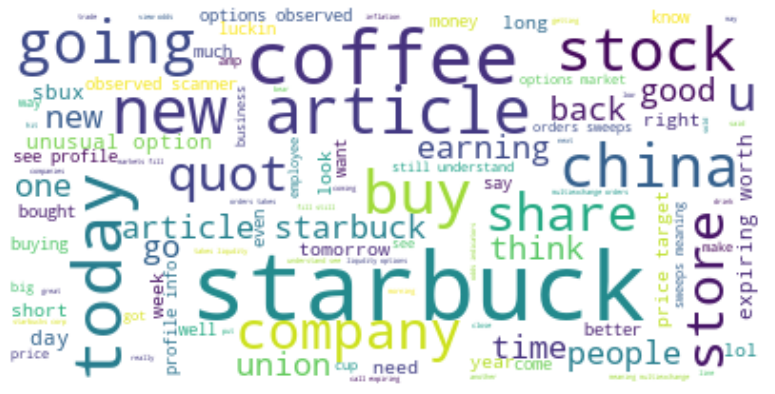

The number of all words:  117624
The number of unique words:  8108
Top 40 frequent words:  ['schwab', 'charles', 'amp', 'form', 'options', 'new', 'shares', 'stock', 'corporation', 'sec', 'k', 'filed', 'worth', 'alerted', 'unusual', 'daily', 'news', 'delayed', 'activity', 'sweepcast', 'expiring', 'stocks', 'insider', 'digest', 'price', 'call', 'r', 'earnings', 'sold', 'schw', 'trading', 'trade', 'see', 'buy', 'common', 'put', 'market', 'exp', 'today', 'pre']


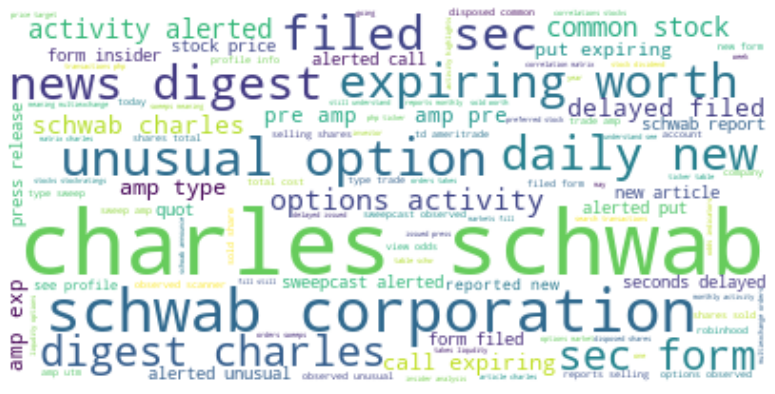

The number of all words:  113657
The number of unique words:  7578
Top 40 frequent words:  ['southern', 'amp', 'company', 'power', 'georgia', 'new', 'form', 'sec', 'filed', 'stock', 'stocks', 'shares', 'delayed', 'daily', 'news', 'options', 'earnings', 'gas', 'utm', 'k', 'customers', 'today', 'digest', 'energy', 'short', 'ceo', 'price', 'president', 'securities', 'release', 'worth', 'common', 'utilities', 'week', 'press', 'article', 'quot', 'day', 'p', 'unusual']


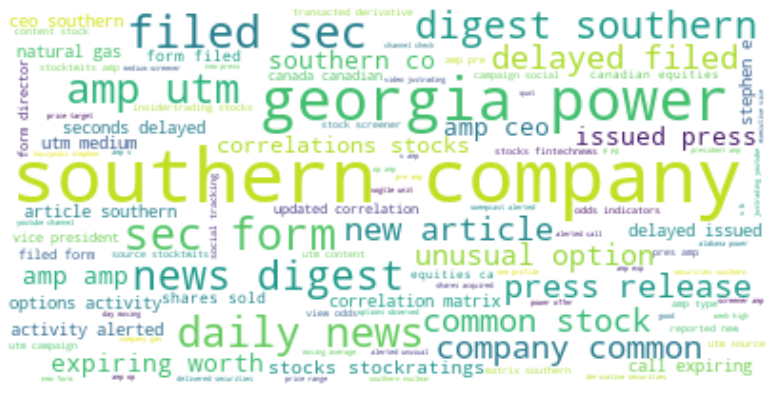

The number of all words:  89901
The number of unique words:  10300
Top 40 frequent words:  ['market', 'week', 'next', 'today', 'like', 'going', 'puts', 'day', 'fed', 'get', 'bears', 'quot', 'go', 'back', 'see', 'time', 'buy', 'lol', 'rally', 'x', 'calls', 'bear', 'still', 'money', 'good', 'spy', 'monday', 'short', 'one', 'right', 'pump', 'inflation', 'think', 'people', 'bulls', 'would', 'know', 'last', 'even', 'big']


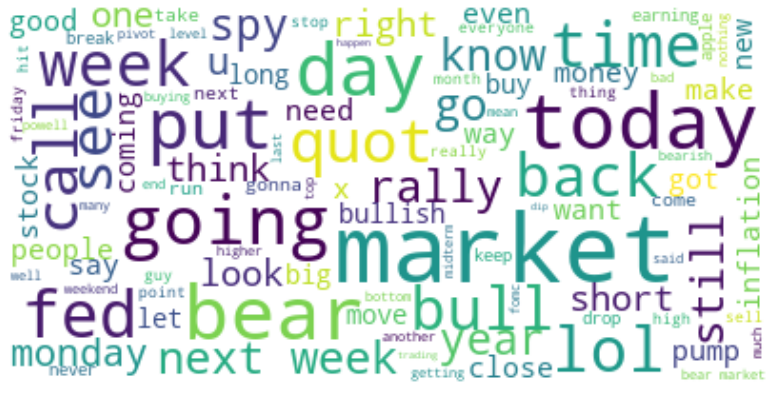

The number of all words:  89627
The number of unique words:  6239
Top 40 frequent words:  ['sempra', 'energy', 'amp', 'filed', 'form', 'new', 'stocks', 'socalgas', 'earnings', 'sec', 'shares', 'delayed', 'director', 'short', 'release', 'report', 'sre', 'stock', 'k', 'price', 'quot', 'gas', 'utilities', 'today', 'securities', 'quarter', 'buy', 'utm', 'eps', 'press', 'portfolio', 'results', 'volume', 'article', 'ago', 'b', 'via', 'q', 'x', 'options']


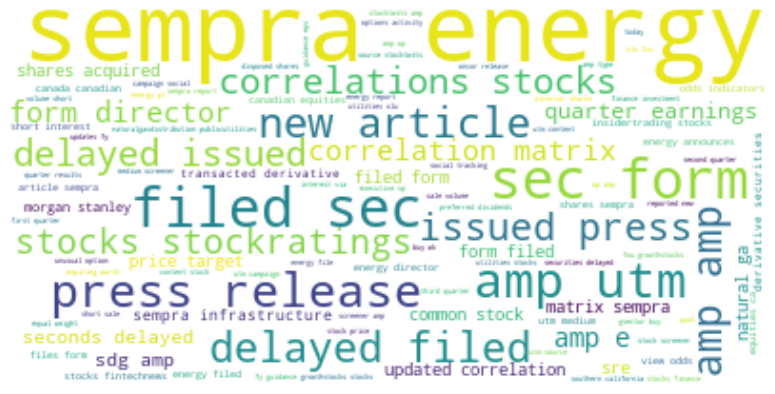

The number of all words:  122028
The number of unique words:  10327
Top 40 frequent words:  ['amp', 'shares', 'options', 'stock', 'market', 'new', 'dividend', 'price', 'k', 'buy', 'today', 'company', 'quot', 'see', 'get', 'like', 'contracts', 'wbd', 'good', 'share', 'day', 'profile', 'earnings', 'time', 'sweep', 'stocks', 'still', 'trading', 'call', 'spin', 'activity', 'analysis', 'discovery', 'going', 'go', 'institutions', 'one', 'week', 'would', 'included']


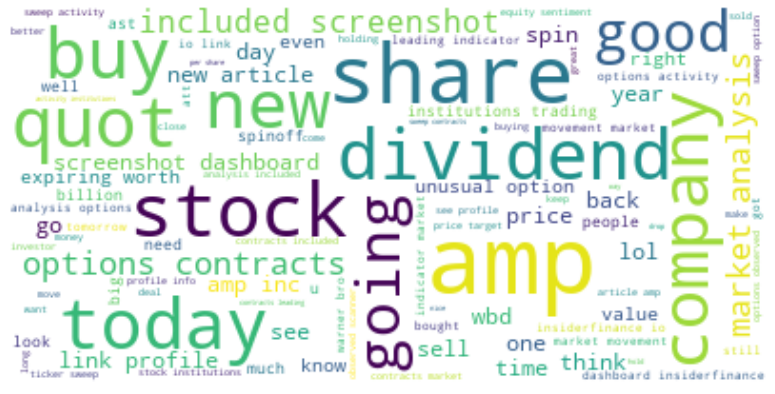

The number of all words:  126899
The number of unique words:  8867
Top 40 frequent words:  ['mobile', 'amp', 'g', 'us', 'new', 'options', 'k', 'unusual', 'long', 'buy', 'delayed', 'worth', 'alerted', 'stock', 'expiring', 'release', 'inc', 'term', 'call', 'sweepcast', 'see', 'press', 'today', 'earnings', 'price', 'activity', 'form', 'tmus', 'bullish', 'market', 'sec', 'article', 'filed', 'day', 'time', 'nasdaq', 'get', 'stocks', 'business', 'big']


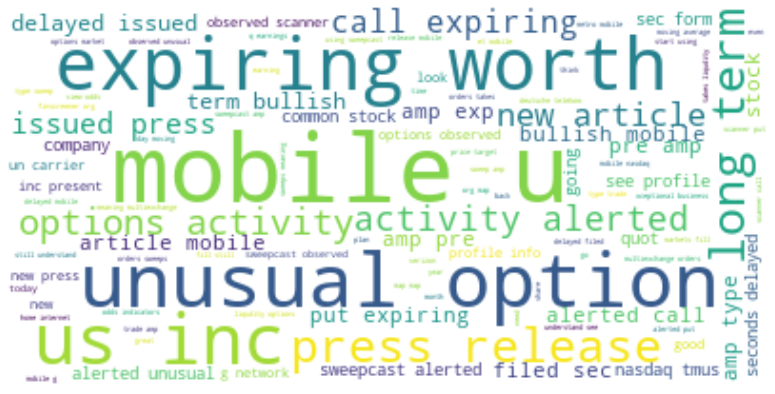

The number of all words:  70741
The number of unique words:  8513
Top 40 frequent words:  ['split', 'tesla', 'today', 'stock', 'market', 'going', 'tomorrow', 'day', 'get', 'like', 'elon', 'buy', 'bears', 'lol', 'go', 'see', 'time', 'calls', 'next', 'week', 'short', 'let', 'bulls', 'back', 'news', 'good', 'puts', 'tsla', 'sell', 'shares', 'money', 'one', 'price', 'quot', 'last', 'new', 'long', 'still', 'k', 'shorts']


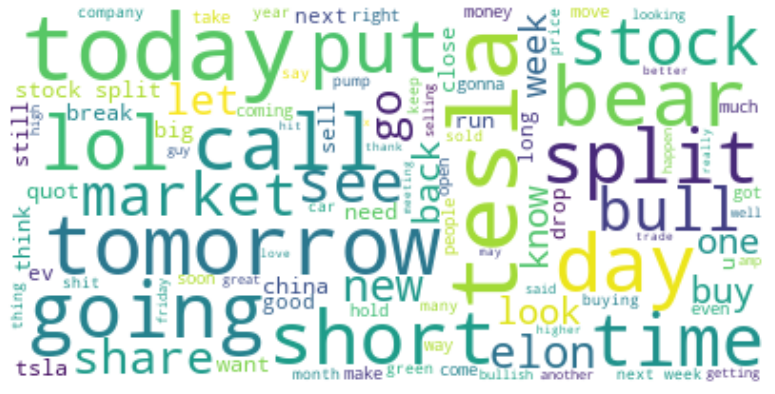

The number of all words:  100720
The number of unique words:  9152
Top 40 frequent words:  ['uber', 'options', 'market', 'stock', 'k', 'buy', 'profile', 'contracts', 'sweep', 'see', 'call', 'new', 'activity', 'today', 'going', 'price', 'link', 'earnings', 'analysis', 'get', 'company', 'like', 'trading', 'time', 'included', 'dashboard', 'screenshot', 'lyft', 'institutions', 'drivers', 'shares', 'day', 'money', 'quot', 'good', 'still', 'puts', 'io', 'insiderfinance', 'week']


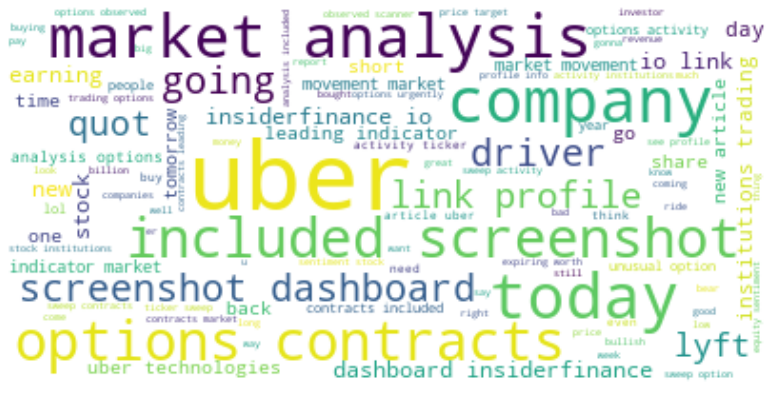

The number of all words:  115444
The number of unique words:  8263
Top 40 frequent words:  ['amp', 'unitedhealth', 'group', 'health', 'new', 'options', 'k', 'stock', 'alerted', 'unusual', 'price', 'worth', 'expiring', 'sweepcast', 'form', 'call', 'earnings', 'shares', 'stocks', 'sec', 'see', 'trade', 'delayed', 'buy', 'unitedhealthcare', 'filed', 'today', 'calls', 'unh', 'healthcare', 'activity', 'care', 'market', 'target', 'release', 'exp', 'puts', 'day', 'put', 'type']


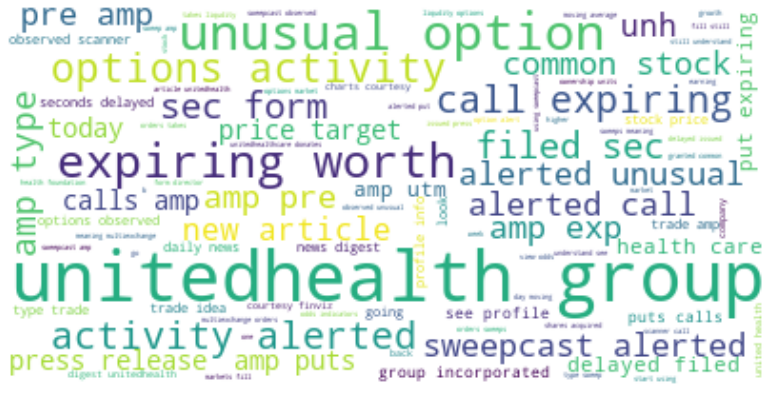

The number of all words:  114382
The number of unique words:  7333
Top 40 frequent words:  ['union', 'pacific', 'amp', 'new', 'form', 'k', 'options', 'sec', 'filed', 'stock', 'earnings', 'stocks', 'shares', 'unusual', 'corporation', 'buy', 'expiring', 'worth', 'call', 'price', 'alerted', 'trade', 'sweepcast', 'unp', 'today', 'see', 'short', 'delayed', 'utm', 'quarter', 'activity', 'week', 'article', 'report', 'market', 'volume', 'put', 'b', 'high', 'release']


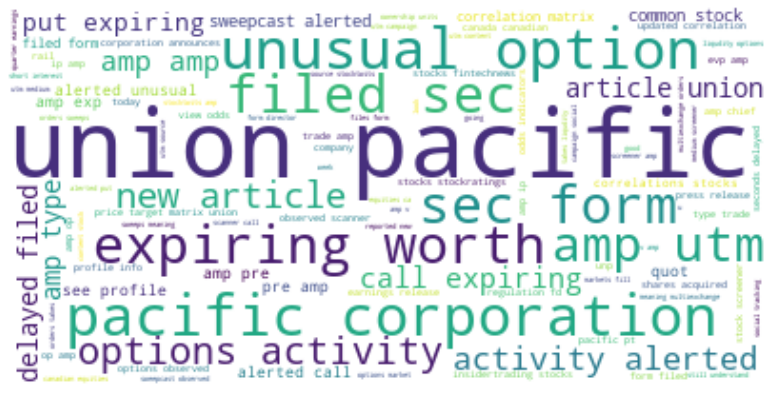

The number of all words:  109254
The number of unique words:  9235
Top 40 frequent words:  ['amp', 'ups', 'options', 'united', 'parcel', 'service', 'alerted', 'buy', 'k', 'earnings', 'unusual', 'see', 'call', 'worth', 'expiring', 'new', 'sweepcast', 'price', 'long', 'market', 'today', 'term', 'stock', 'calls', 'activity', 'trade', 'day', 'bullish', 'time', 'pre', 'exp', 'put', 'delayed', 'good', 'stocks', 'x', 'like', 'type', 'get', 'week']


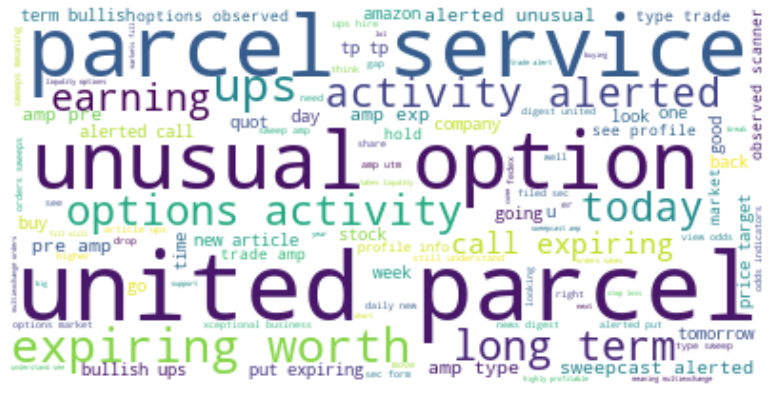

The number of all words:  86679
The number of unique words:  6075
Top 40 frequent words:  ['united', 'rentals', 'amp', 'earnings', 'form', 'k', 'options', 'daily', 'shares', 'stock', 'filed', 'news', 'call', 'sec', 'buy', 'new', 'short', 'digest', 'price', 'unusual', 'today', 'worth', 'expiring', 'uri', 'alerted', 'quot', 'see', 'stocks', 'sweepcast', 'b', 'inc', 'delayed', 'put', 'utm', 'director', 'market', 'report', 'eps', 'trade', 'volume']


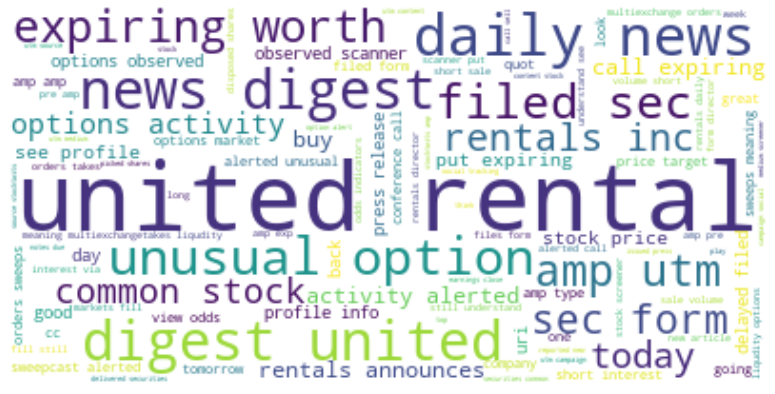

The number of all words:  104340
The number of unique words:  9615
Top 40 frequent words:  ['visa', 'buy', 'options', 'amp', 'new', 'market', 'stock', 'see', 'today', 'earnings', 'price', 'k', 'x', 'day', 'like', 'v', 'good', 'get', 'stocks', 'quot', 'credit', 'going', 'long', 'unusual', 'card', 'call', 'worth', 'shares', 'time', 'still', 'back', 'expiring', 'inc', 'short', 'sell', 'article', 'week', 'spending', 'go', 'year']


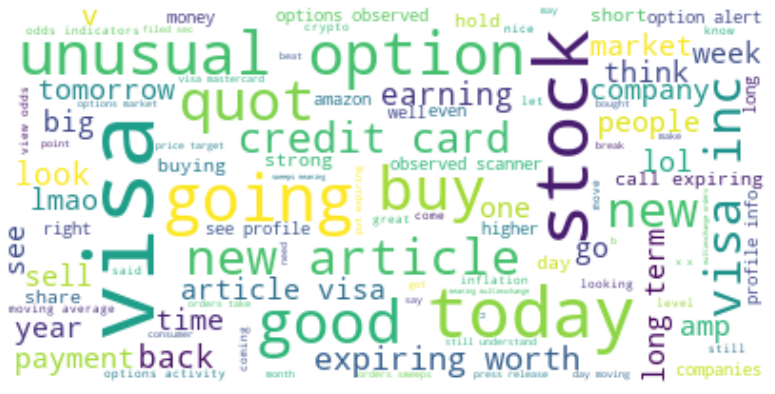

The number of all words:  63494
The number of unique words:  5486
Top 40 frequent words:  ['vulcan', 'materials', 'company', 'earnings', 'amp', 'form', 'stocks', 'filed', 'new', 'shares', 'sec', 'stock', 'short', 'call', 'vmc', 'eps', 'k', 'volume', 'quarter', 'buy', 'report', 'price', 'q', 'delayed', 'today', 'quot', 'trade', 'insider', 'announces', 'options', 'quarterly', 'financial', 'day', 'securities', 'via', 'pt', 'results', 'p', 'market', 'trading']


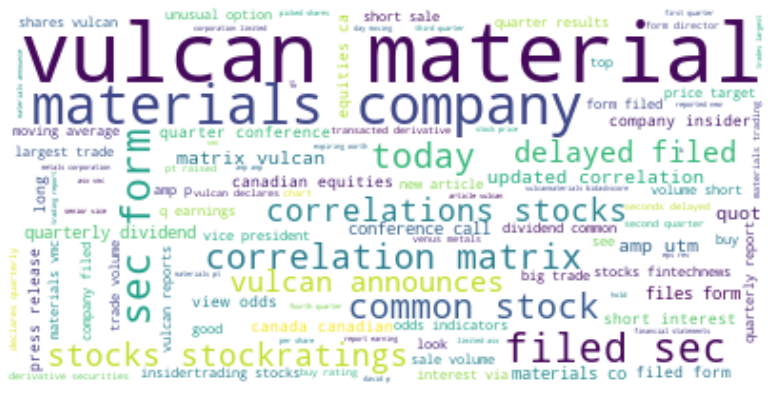

The number of all words:  104897
The number of unique words:  8929
Top 40 frequent words:  ['verizon', 'amp', 'options', 'g', 'new', 'delayed', 'market', 'stock', 'form', 'k', 'filed', 'sec', 'shares', 'dividend', 'buy', 'see', 'like', 'vz', 'communications', 'price', 'today', 'earnings', 'get', 'call', 'stocks', 'unusual', 'day', 'worth', 'quot', 'expiring', 'business', 'article', 'activity', 'time', 'still', 'evp', 'seconds', 'profile', 'year', 'good']


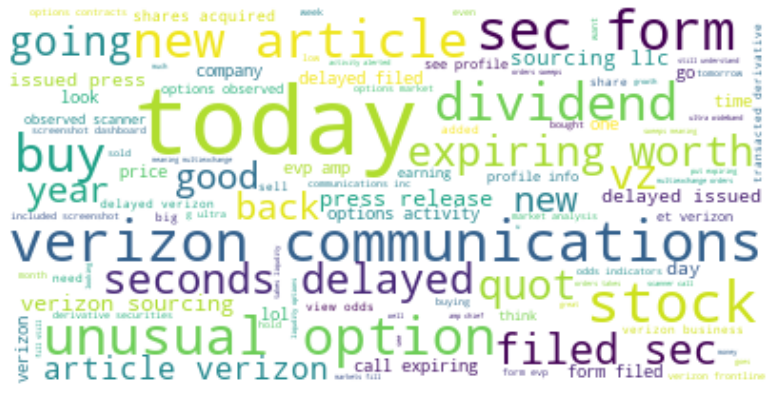

The number of all words:  116490
The number of unique words:  8661
Top 40 frequent words:  ['k', 'contracts', 'wells', 'fargo', 'amp', 'options', 'market', 'new', 'earnings', 'banks', 'activity', 'company', 'stock', 'bank', 'sweep', 'today', 'call', 'buy', 'unusual', 'day', 'expiring', 'release', 'sweepcast', 'stocks', 'worth', 'see', 'wfc', 'price', 'alerted', 'form', 'week', 'trading', 'filed', 'dashboard', 'time', 'profile', 'press', 'sec', 'institutions', 'option']


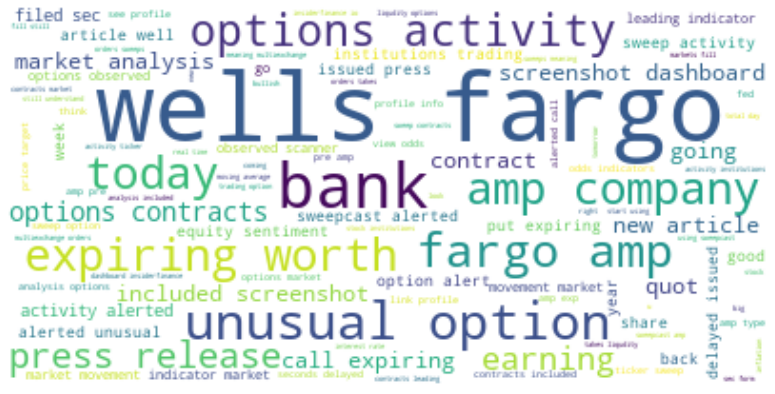

The number of all words:  92684
The number of unique words:  6377
Top 40 frequent words:  ['gt', 'sector', 'materials', 'amp', 'k', 'sectorbreadth', 'short', 'sectors', 'bullishness', 'p', 'contracts', 'today', 'quot', 'daily', 'etf', 'energy', 'price', 'stocks', 'etfs', 'market', 'buy', 'options', 'f', 'new', 'week', 'rank', 'weakest', 'expected', 'strongest', 'long', 'stock', 'spdr', 'returns', 'unusual', 'vs', 'day', 'volume', 'sell', 'select', 'xlb']


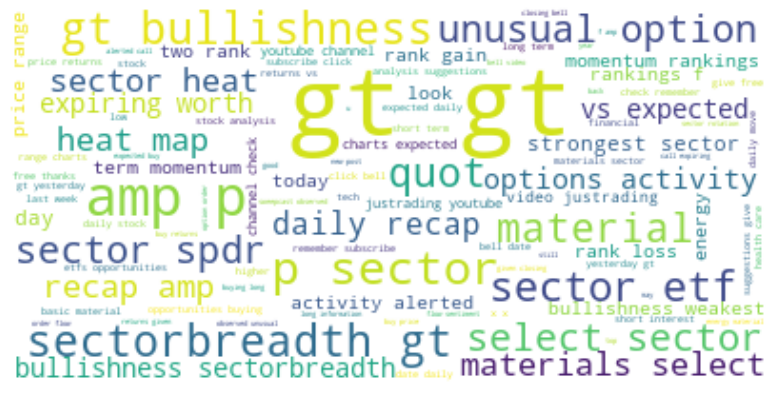

The number of all words:  30667
The number of unique words:  4033
Top 40 frequent words:  ['amp', 'gt', 'short', 'sector', 'options', 'stocks', 'today', 'volume', 'buy', 'new', 'etf', 'k', 'stock', 'etfs', 'price', 'communication', 'quot', 'sectors', 'daily', 'unusual', 'xlc', 'trade', 'bell', 'video', 'week', 'services', 'charts', 'market', 'see', 'analysis', 'sell', 'sweepcast', 'close', 'trading', 'p', 'via', 'long', 'worth', 'bullish', 'check']


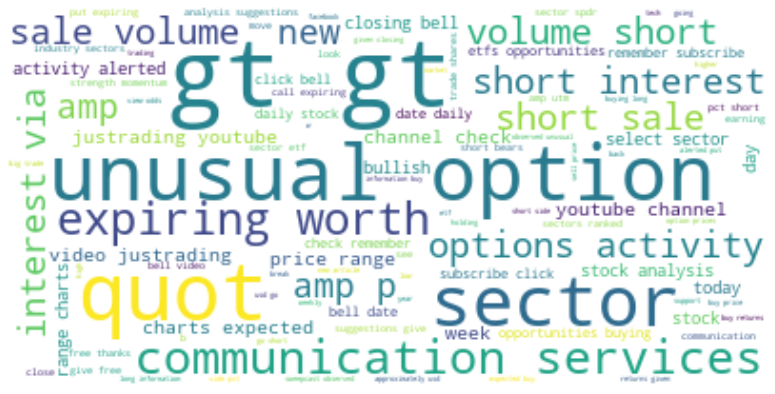

The number of all words:  174094
The number of unique words:  12912
Top 40 frequent words:  ['oil', 'energy', 'quot', 'market', 'etf', 'amp', 'gas', 'trading', 'k', 'prices', 'sector', 'week', 'stocks', 'price', 'options', 'us', 'year', 'crude', 'f', 'new', 'see', 'dashboard', 'analysis', 'like', 'profile', 'today', 'long', 'contracts', 'day', 'link', 'said', 'last', 'sentiment', 'going', 'would', 'institutions', 'still', 'short', 'included', 'higher']


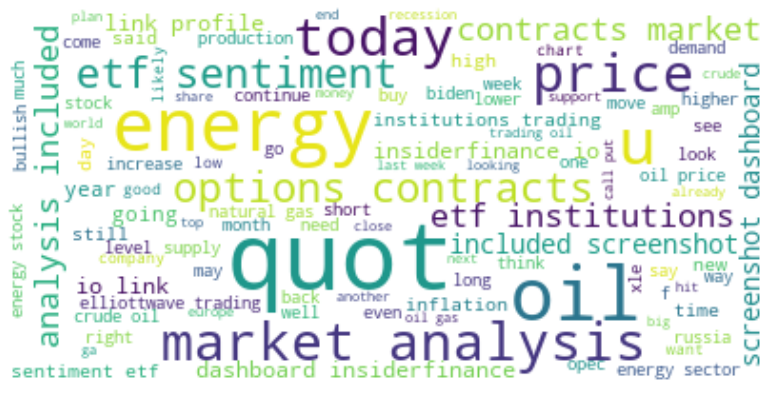

The number of all words:  165832
The number of unique words:  10712
Top 40 frequent words:  ['k', 'contracts', 'etf', 'market', 'quot', 'trading', 'dashboard', 'amp', 'options', 'analysis', 'sentiment', 'banks', 'institutions', 'financials', 'stocks', 'included', 'day', 'screenshot', 'financial', 'time', 'like', 'sector', 'q', 'week', 'elliottwave', 'money', 'today', 'bank', 'gt', 'profile', 'b', 'top', 'year', 'higher', 'put', 'call', 'link', 'real', 'next', 'new']


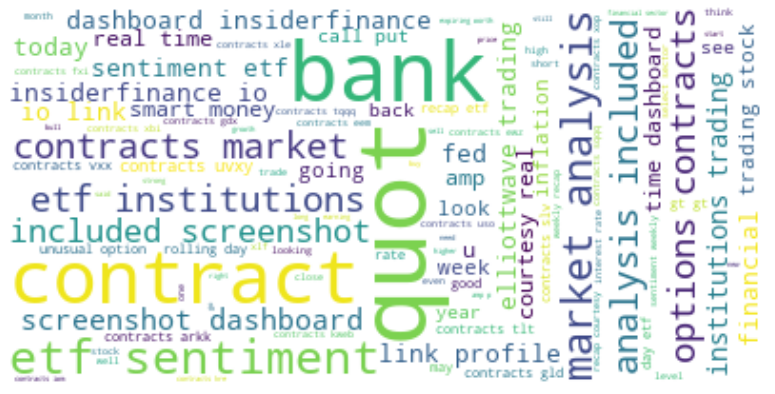

The number of all words:  125264
The number of unique words:  6446
Top 40 frequent words:  ['k', 'contracts', 'trading', 'elliottwave', 'amp', 'short', 'sector', 'gt', 'etf', 'area', 'update', 'higher', 'industrials', 'stocks', 'options', 'long', 'expected', 'view', 'industrial', 'market', 'box', 'trade', 'blue', 'new', 'sentiment', 'week', 'time', 'price', 'today', 'daily', 'sectors', 'buy', 'lower', 'p', 'bullish', 'showing', 'f', 'term', 'xli', 'unusual']


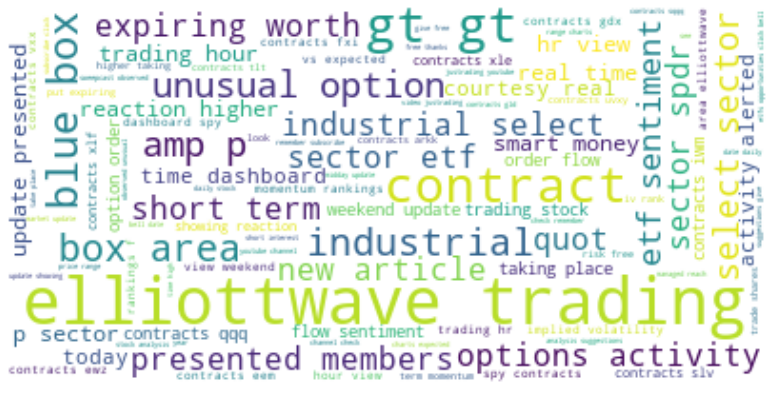

The number of all words:  147581
The number of unique words:  9767
Top 40 frequent words:  ['k', 'contracts', 'gt', 'trading', 'amp', 'elliottwave', 'tech', 'sector', 'stocks', 'market', 'view', 'technology', 'update', 'hr', 'etf', 'new', 'quot', 'week', 'options', 'weekend', 'day', 'today', 'time', 'short', 'area', 'higher', 'lower', 'chart', 'expected', 'high', 'sectors', 'top', 'see', 'level', 'showing', 'close', 'last', 'like', 'box', 'buy']


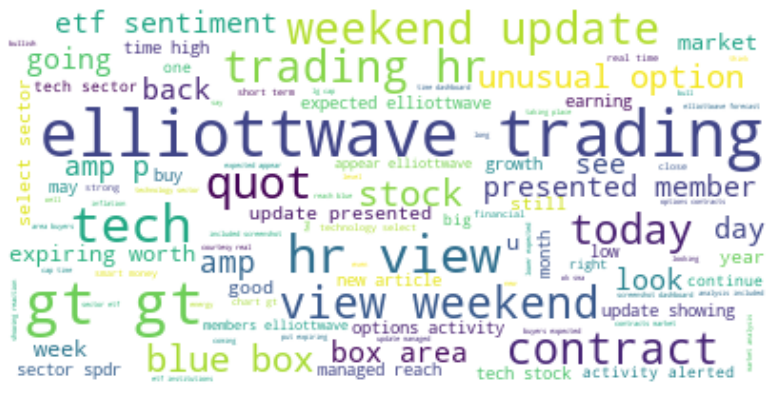

The number of all words:  129552
The number of unique words:  7084
Top 40 frequent words:  ['elliottwave', 'trading', 'amp', 'k', 'contracts', 'area', 'staples', 'update', 'higher', 'view', 'consumer', 'blue', 'sector', 'short', 'box', 'market', 'etf', 'stocks', 'gt', 'hr', 'new', 'expected', 'options', 'risk', 'place', 'members', 'sectors', 'buying', 'showing', 'term', 'today', 'pullback', 'bullish', 'low', 'week', 'looking', 'free', 'presented', 'chart', 'price']


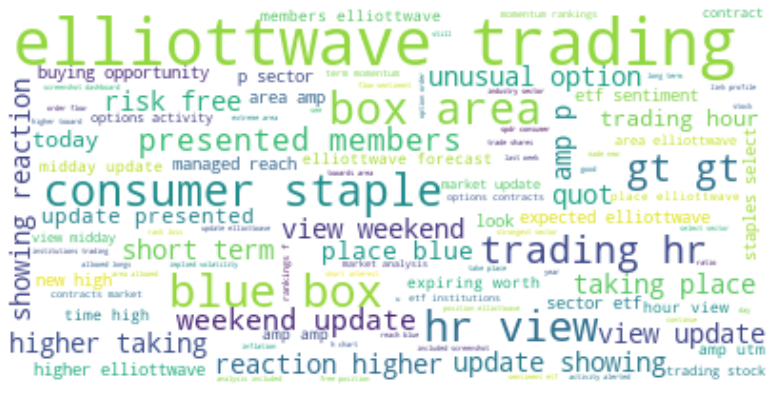

The number of all words:  38483
The number of unique words:  4855
Top 40 frequent words:  ['amp', 'short', 'sector', 'real', 'estate', 'p', 'sectors', 'reits', 'etf', 'today', 'stocks', 'f', 'market', 'volume', 'momentum', 'term', 'long', 'time', 'quot', 'new', 'price', 'buy', 'utm', 'rankings', 'high', 'interest', 'list', 'week', 'stock', 'daily', 'via', 'utilities', 'cap', 'xlre', 'year', 'top', 'close', 'us', 'q', 'lg']


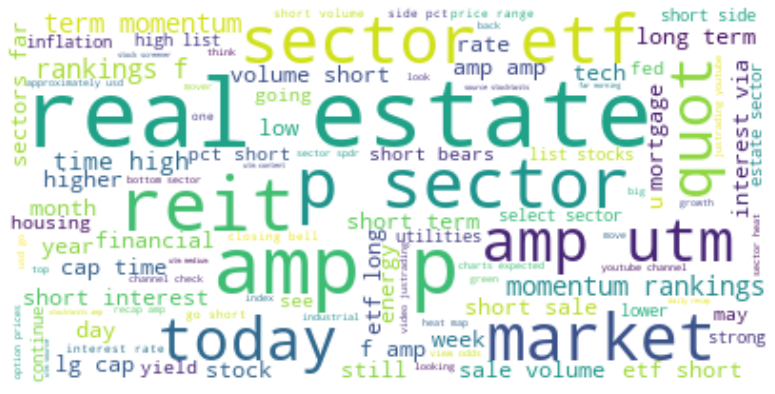

The number of all words:  114094
The number of unique words:  7392
Top 40 frequent words:  ['k', 'contracts', 'utilities', 'amp', 'sector', 'etf', 'market', 'short', 'options', 'today', 'week', 'sectors', 'stocks', 'gt', 'sentiment', 'trading', 'rank', 'new', 'stock', 'analysis', 'price', 'dashboard', 'time', 'energy', 'top', 'xlu', 'bullishness', 'day', 'buy', 'see', 'sell', 'trade', 'option', 'daily', 'profile', 'bullish', 'p', 'long', 'unusual', 'utm']


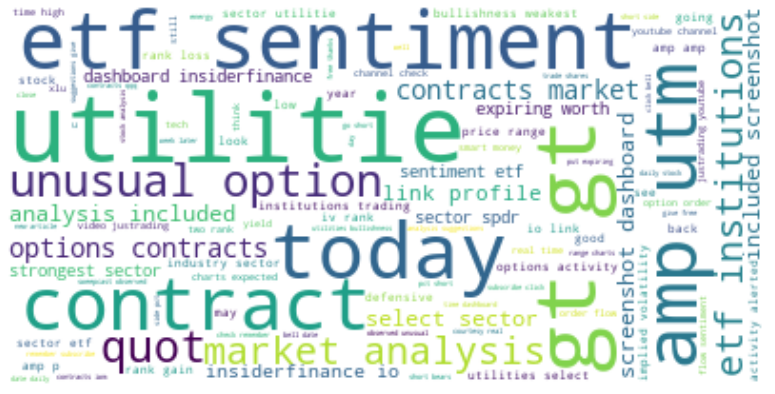

The number of all words:  159980
The number of unique words:  9336
Top 40 frequent words:  ['k', 'contracts', 'trading', 'elliottwave', 'view', 'area', 'update', 'box', 'blue', 'amp', 'higher', 'hr', 'healthcare', 'place', 'market', 'stocks', 'members', 'etf', 'sector', 'short', 'expected', 'showing', 'health', 'presented', 'taking', 'options', 'hour', 'reaction', 'care', 'time', 'buying', 'pullback', 'lower', 'new', 'like', 'free', 'take', 'chart', 'risk', 'get']


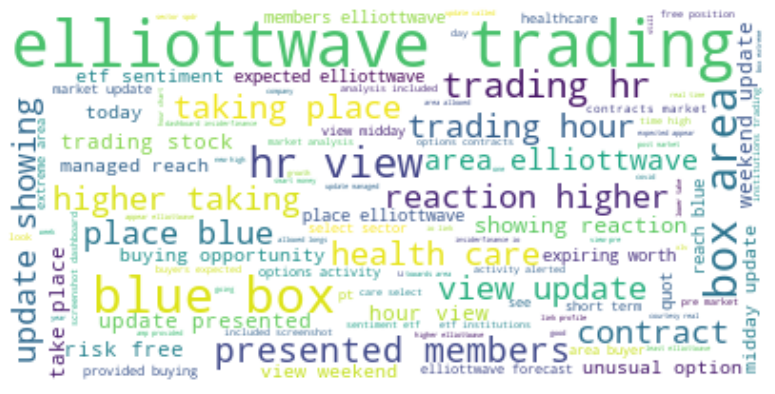

The number of all words:  128922
The number of unique words:  7580
Top 40 frequent words:  ['elliottwave', 'trading', 'amp', 'k', 'consumer', 'contracts', 'short', 'stocks', 'gt', 'sector', 'higher', 'area', 'discretionary', 'view', 'etf', 'new', 'update', 'market', 'long', 'blue', 'expected', 'today', 'box', 'lower', 'options', 'sectors', 'bounce', 'week', 'term', 'price', 'retail', 'p', 'quot', 'stock', 'etfs', 'f', 'see', 'hour', 'high', 'pullback']


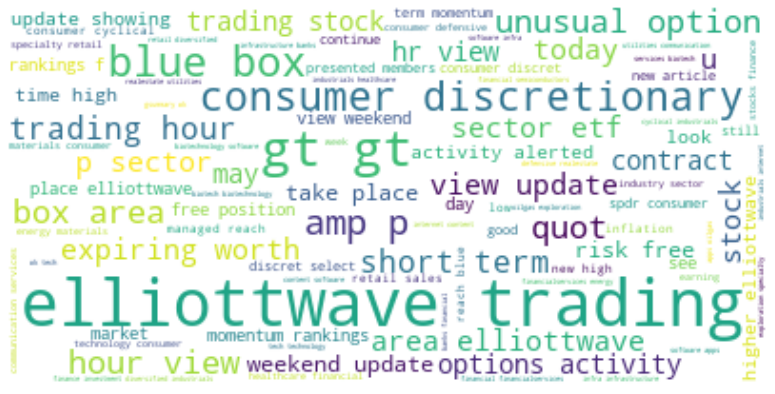

The number of all words:  115379
The number of unique words:  10866
Top 40 frequent words:  ['oil', 'market', 'gas', 'quot', 'options', 'amp', 'energy', 'exxon', 'prices', 'buy', 'week', 'trading', 'price', 'stock', 'stocks', 'today', 'biden', 'k', 'going', 'see', 'like', 'new', 'time', 'profile', 'go', 'next', 'still', 'get', 'back', 'contracts', 'call', 'day', 'xom', 'analysis', 'mobil', 'short', 'money', 'high', 'good', 'last']


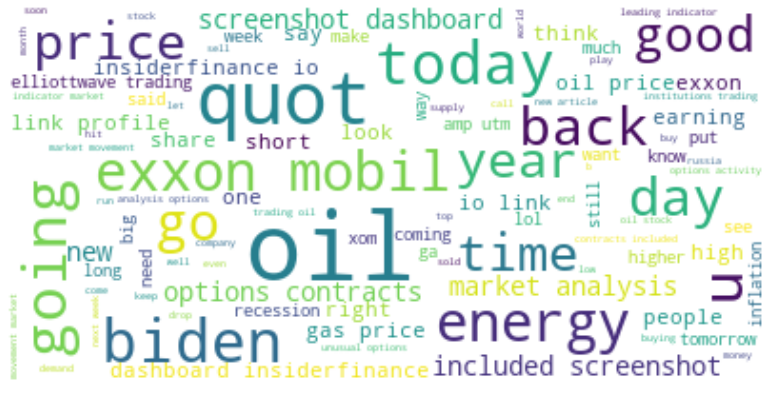

The number of all words:  90048
The number of unique words:  9888
Top 40 frequent words:  ['apple', 'market', 'earnings', 'going', 'today', 'like', 'quot', 'buy', 'amp', 'get', 'puts', 'stock', 'tomorrow', 'time', 'new', 'go', 'day', 'see', 'good', 'next', 'china', 'week', 'back', 'short', 'calls', 'bears', 'lol', 'recession', 'money', 'big', 'one', 'inflation', 'last', 'think', 'let', 'would', 'price', 'long', 'still', 'call']


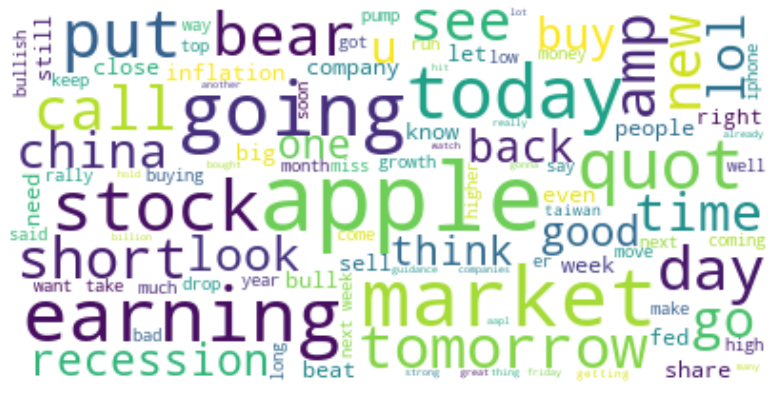

In [10]:
explore_frequent_words(messages)

# Data Preparation & Features Selection


*   Validate data - normal distribution
*   Data Distribution
*   Split training data & test data

In [11]:
StockTwits = pd.read_csv(r"Data/StockTwits/StockTwits.csv", sep="\t")
print(StockTwits.describe())

          Unnamed: 0          label
count  670618.000000  670618.000000
mean     4925.781502       1.110227
std      2884.689601       0.484336
min         0.000000       0.000000
25%      2414.000000       1.000000
50%      4902.000000       1.000000
75%      7406.000000       1.000000
max     10019.000000       2.000000


In [12]:
StockTwits

,Unnamed: 0,quote,date,time_ET,org message,sentence,label
0,0,AAPL,2022-08-05,12:18:04,$AAPL looking for puts to pay,looking puts pay,0
1,1,AAPL,2022-08-05,12:17:36,$AAPL,NaN,1
2,2,AAPL,2022-08-05,12:17:26,$SPY Moves already happened. Retrace - CPR/Gap...,moves already happened retrace cpr gapfill sub...,1
3,3,AAPL,2022-08-05,12:16:06,$AMZN $AAPL $TSLA $AMD Jobs growth for July is...,jobs growth july seasonally higher jobs due su...,2
4,4,AAPL,2022-08-05,12:15:31,$AAPL i sold this pos 🩸🩸🩸🩸🩸🩸🩸🩸💩💩💩💩 $AMZN $MS...,sold pos,0
...,...,...,...,...,...,...,...
670613,10015,AAPL-checkpoint,2022-07-27,16:46:11,$META $qcom $aapl $amzn $tsla There goes Meta....,goes meta markets roll,1
670614,10016,AAPL-checkpoint,2022-07-27,16:44:38,$AAPL you think 25 PE is realistic? Good years...,think pe realistic good years apple around,0
670615,10017,AAPL-checkpoint,2022-07-27,16:42:46,$SOLO Sold 500 shares at 1.44 and picked up an...,sold shares picked another jan call thats days...,2
670616,10018,AAPL-checkpoint,2022-07-27,16:42:41,$SPY $TSLA $AAPL Bears carbon footprint too la...,bears carbon footprint large greta,1


In [13]:
def explore_frequent_words_all(messages): 
    preprocesseds = []
    # Process for all messages
    preprocessed = [preprocess(msg) for msg in message]
    preprocesseds.append(preprocessed)

    all_words = [word for message in preprocessed for word in message.split()]
    print('The number of all words: ', len(all_words))

    counts = Counter(all_words)
    print('The number of unique words: ', len(counts))

    bow = sorted(counts, key=counts.get, reverse=True)
    print('Top 40 frequent words: ', bow[:40])

    text = " ".join(all_words)

    # Generate a word cloud image
    wordcloud = WordCloud(stopwords=None, max_font_size=50, max_words=100, background_color="white").generate(text)
    plt.figure(figsize=(15,7))
    # Display the generated image:
    # the matplotlib way:
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()

The number of all words:  90048
The number of unique words:  9888
Top 40 frequent words:  ['apple', 'market', 'earnings', 'going', 'today', 'like', 'quot', 'buy', 'amp', 'get', 'puts', 'stock', 'tomorrow', 'time', 'new', 'go', 'day', 'see', 'good', 'next', 'china', 'week', 'back', 'short', 'calls', 'bears', 'lol', 'recession', 'money', 'big', 'one', 'inflation', 'last', 'think', 'let', 'would', 'price', 'long', 'still', 'call']


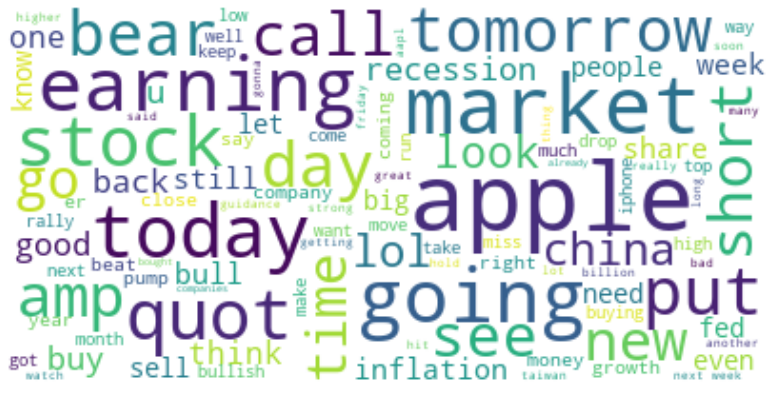

In [14]:
explore_frequent_words_all(StockTwits['sentence'])

In [15]:
len(StockTwits['sentence'])

670618

<AxesSubplot:ylabel='Density'>

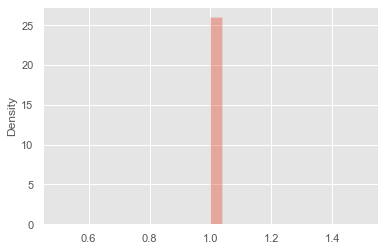

In [16]:
sns.distplot([len(x) for x in str(StockTwits['sentence'])])

The total number of data:  670618


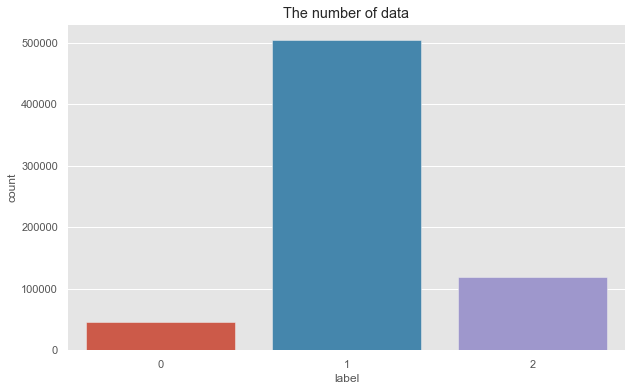

In [17]:
print("The total number of data: ", len(StockTwits['label']))
plt.figure(figsize=(10,6))
sns.countplot(x=StockTwits['label'])
plt.title('The number of data')
plt.show()

0 = negative 1 = neutral 2 = positive

Obviously, the negative of the data is imbalance. Sometimes imbalanced data required to balanced using methods like resampling (oversampling, undersampling) as models tend to predict the majority class more. SMOTE or the Synthetic Minority Over-sampling Technique is a popular technique for oversampling but it is a statistical method for numerical data.

Here, take label = 0, 1, 2 and balance the data using random down sampling method

In [18]:
# Set Random Seed

import torch
random.seed(42)
np.random.seed(42)
rand_seed = 42
torch.manual_seed(42)
torch.cuda.manual_seed(42)

In [19]:
# Take 0, 2, 4 and update them to 0, 1, 2
train_df = StockTwits.loc[(StockTwits['label']==int(0))|(StockTwits['label']==int(1))|(StockTwits['label']==int(2))]
def update_label(x):
    if x == int(2):
        return int(2)
    elif x == int(1):
        return int(1)
    else:
        return int(0)
train_df['label'] = train_df['label'].apply(lambda x: update_label(x))

# Balancing the data
n_negative = sum(1 for each in train_df['label'] if each == 0)
n_neutral = sum(1 for each in train_df['label'] if each == 1)
n_positive = sum(1 for each in train_df['label'] if each == 2)
N_examples = train_df.shape[0]

print(n_negative)
print(n_neutral)
print(n_positive)
print(N_examples)

print('Negative:', n_negative/N_examples)
print('Neutral: ', n_neutral/N_examples)
print('Positive:', n_positive/N_examples)
print('Total records: ', N_examples)

balanced = {'org message': [], 'sentence': [], 'label': []}

# Keep probability
# As the negative has the least number of data, trim neutral and positive
keep_prob_neutral = n_negative/n_neutral
keep_prob_positive = n_negative/n_positive
#keep_prob = 1

for i, row in train_df.iterrows():
    if str(row['sentence']).strip() == "":
        continue
    elif (row['label'] == 0) or ((row['label'] == 1) and (random.random() < keep_prob_neutral)) or ((row['label'] == 2) and (random.random() < keep_prob_positive)):
        balanced['org message'].append(row['org message'])
        balanced['sentence'].append(str(row['sentence']))
        balanced['label'].append(row['label'])

train_df = pd.DataFrame(balanced)
n_negative = sum(1 for each in train_df['label'] if each == 0)
n_neutral = sum(1 for each in train_df['label'] if each == 1)
n_positive = sum(1 for each in train_df['label'] if each == 2)
N_examples = len(train_df)

print('Negative:', n_negative/N_examples)
print('Neutral: ', n_neutral/N_examples)
print('Positive:', n_positive/N_examples)
print('Total records: ', N_examples)

45771
505156
119691
670618
Negative: 0.06825197057042906
Neutral:  0.7532693724296097
Positive: 0.17847865699996124
Total records:  670618
Negative: 0.333649213094917
Neutral:  0.33413032227025213
Positive: 0.33222046463483085
Total records:  137183


The total number of data:  137183


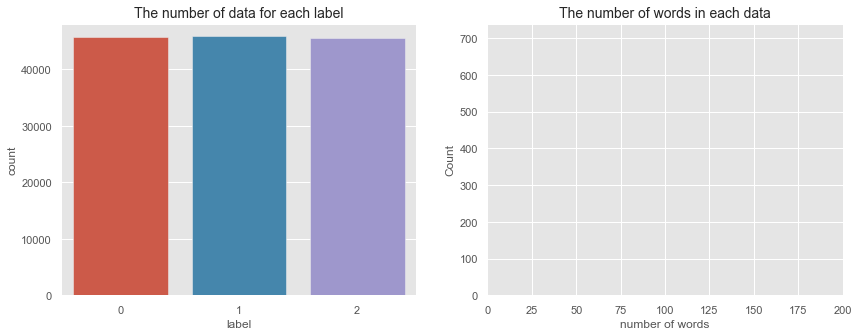

In [20]:
print("The total number of data: ", len(train_df))
fig, (ax1, ax2) = plt.subplots(1,2,figsize=(14,5))
sns.countplot(x='label', data=train_df, ax=ax1)
ax1.set_title('The number of data for each label', fontsize=14)

sns.histplot([len(x) for x in str(train_df['sentence'])], ax=ax2, bins=100)
ax2.set_title('The number of words in each data', fontsize=14)
ax2.set_xlim(0,200)
ax2.set_xlabel('number of words')
plt.show()

In [21]:
train_df.to_csv(r"Data/StockTwits/StockTwits_Balance.csv", sep="\t")    

In [22]:
train_df

,org message,sentence,label
0,$AAPL looking for puts to pay,looking puts pay,0
1,$SPY Moves already happened. Retrace - CPR/Gap...,moves already happened retrace cpr gapfill sub...,1
2,$AMZN $AAPL $TSLA $AMD Jobs growth for July is...,jobs growth july seasonally higher jobs due su...,2
3,$AAPL i sold this pos 🩸🩸🩸🩸🩸🩸🩸🩸💩💩💩💩 $AMZN $MS...,sold pos,0
4,$AMZN $AAPL $SHIB.X $BTC.X $AMC is pouncing ha...,x x pouncing hard time comin,2
...,...,...,...
137178,$AAPL tomorrow,tomorrow,0
137179,"The death of FAANG has arrived, and we welcome...",death faang arrived welcome age maage,2
137180,$TTD tomorrow is gonna be nasty (in a bad way)...,tomorrow gonna nasty bad way today earnings gu...,0
137181,$AAPL you think 25 PE is realistic? Good years...,think pe realistic good years apple around,0


The number of all words:  90048
The number of unique words:  9888
Top 40 frequent words:  ['apple', 'market', 'earnings', 'going', 'today', 'like', 'quot', 'buy', 'amp', 'get', 'puts', 'stock', 'tomorrow', 'time', 'new', 'go', 'day', 'see', 'good', 'next', 'china', 'week', 'back', 'short', 'calls', 'bears', 'lol', 'recession', 'money', 'big', 'one', 'inflation', 'last', 'think', 'let', 'would', 'price', 'long', 'still', 'call']


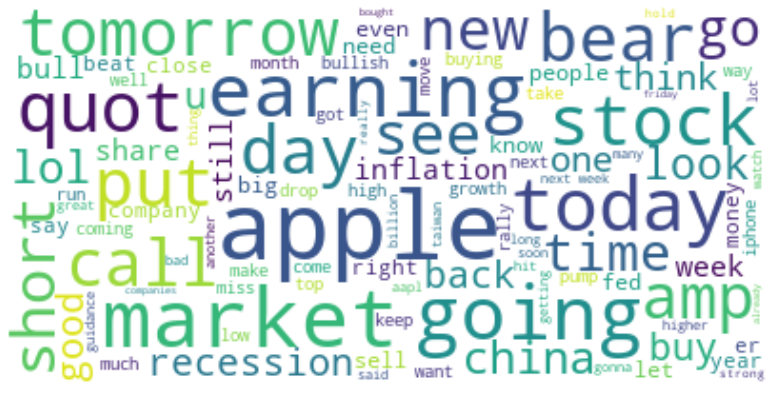

In [23]:
explore_frequent_words_all(train_df['sentence'])